In [38]:
#from shapely.geometry import Point
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from haversine import haversine
from datetime import datetime
import seaborn as sns
import matplotlib
from matplotlib.pyplot import figure
from matplotlib.dates import DateFormatter
from matplotlib.lines import Line2D
import numpy as np

In [39]:
df_initial = pd.read_csv(r'../../data/tidy/large/vehicle-locations-Oct2021toSep2022.csv', delimiter=',', skiprows=0, low_memory=False)

In [40]:
df=df_initial.copy()

In [56]:
df.head()

,Unnamed: 0,ServiceDateTime,DateKey,CalendarDate,Year,Month,OpKey,Operator,RtKey,RtKey2,...,Alights,Onboard,Bike,Daytype,Hour,Minute,Second,Date,time_delta,time_delta_in_seconds
1365147,1365147,2021-10-01 06:43:49,8578,2021-10-01 00:00:00.000,2021,10,1,VATCo,3386,1006,...,0,0,1,0,6,43,49,2021-10-01,NaT,NaN
1365148,1365148,2021-10-01 06:51:53,8578,2021-10-01 00:00:00.000,2021,10,1,VATCo,3386,1006,...,1,0,0,0,6,51,53,2021-10-01,2023-03-24 00:08:04,484.0
1365830,1365830,2021-10-01 06:51:53,8578,2021-10-01 00:00:00.000,2021,10,1,VATCo,3387,3380,...,0,0,1,0,6,51,53,2021-10-01,2023-03-24 00:00:00,0.0
1365831,1365831,2021-10-01 06:52:53,8578,2021-10-01 00:00:00.000,2021,10,1,VATCo,3387,3380,...,0,0,0,0,6,52,53,2021-10-01,2023-03-24 00:01:00,60.0
1365832,1365832,2021-10-01 06:54:38,8578,2021-10-01 00:00:00.000,2021,10,1,VATCo,3387,3380,...,0,0,0,0,6,54,38,2021-10-01,2023-03-24 00:01:45,105.0


In [57]:
df

,Unnamed: 0,ServiceDateTime,DateKey,CalendarDate,Year,Month,OpKey,Operator,RtKey,RtKey2,...,Alights,Onboard,Bike,Daytype,Hour,Minute,Second,Date,time_delta,time_delta_in_seconds
1365147,1365147,2021-10-01 06:43:49,8578,2021-10-01 00:00:00.000,2021,10,1,VATCo,3386,1006,...,0,0,1,0,6,43,49,2021-10-01,NaT,NaN
1365148,1365148,2021-10-01 06:51:53,8578,2021-10-01 00:00:00.000,2021,10,1,VATCo,3386,1006,...,1,0,0,0,6,51,53,2021-10-01,2023-03-24 00:08:04,484.0
1365830,1365830,2021-10-01 06:51:53,8578,2021-10-01 00:00:00.000,2021,10,1,VATCo,3387,3380,...,0,0,1,0,6,51,53,2021-10-01,2023-03-24 00:00:00,0.0
1365831,1365831,2021-10-01 06:52:53,8578,2021-10-01 00:00:00.000,2021,10,1,VATCo,3387,3380,...,0,0,0,0,6,52,53,2021-10-01,2023-03-24 00:01:00,60.0
1365832,1365832,2021-10-01 06:54:38,8578,2021-10-01 00:00:00.000,2021,10,1,VATCo,3387,3380,...,0,0,0,0,6,54,38,2021-10-01,2023-03-24 00:01:45,105.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15569308,15569308,2022-09-30 23:56:37,8942,2022-09-30 00:00:00.000,2022,9,1,VATCo,3995,1001,...,0,2,0,0,23,56,37,2022-09-30,2023-03-24 00:00:31,31.0
15569309,15569309,2022-09-30 23:56:58,8942,2022-09-30 00:00:00.000,2022,9,1,VATCo,3995,1001,...,0,2,0,0,23,56,58,2022-09-30,2023-03-24 00:00:21,21.0
15569310,15569310,2022-09-30 23:58:24,8942,2022-09-30 00:00:00.000,2022,9,1,VATCo,3995,1001,...,0,2,0,0,23,58,24,2022-09-30,2023-03-24 00:01:26,86.0
15569311,15569311,2022-09-30 23:58:42,8942,2022-09-30 00:00:00.000,2022,9,1,VATCo,3995,1001,...,0,2,0,0,23,58,42,2022-09-30,2023-03-24 00:00:18,18.0


In [44]:
len(df.Vehicle.unique())

213

In [45]:
print(df.Vehicle.unique())

[7901 7811 7660 7661 7813 7814 7553 7802 7801 7816 7662 7554 7552 5574
 7812 7815 7551 1860 1855 1657 1843 1323 1564 1643 1660 1817 1671 1566
 1642 1654 1322 1659 1721 1644 1662 1649 1568 1837 1578 1856 1842 1619
 1845 1321 1717 1555 1663 1552 1801 1567 1835 1653 1850 1710 1725 1557
 1672 1650 1848 1575 1861 1812 1823 1658 1836 1854 1655 1857 1822 1821
 1421 1853 1844 1814 1804 1815 1416 1858 1811 1841 1824 1640 1803 1670
 1652 1714 1712 1727 1716 1728 1648 1805 1849 1574 1553 1572 1723 1563
 1722 1577 1720 1715 1410 1415 1711 3312 3322 3303 3319 3402 3401 3302
 3323 3318 3313 3307 3222 3310 3311 3305 3225 3501 3301 3226 3316 3308
 3317 1859 1656 1852 1813 1847 1726 3321 1802 7610 1205 1565 1576 1420
 3223 3320 3306 7550 1826 1833 1851 1834 1701 1729 3324 3212 1411 3309
 7902 1661 1819 1412 1571 3228 1724 3314 1413 3221 1831 3325 3304 1840
 1651 1719 1862 1864 3326 1825 1832 1664 1320 1718 1816 1556 1830 1818
 1510 1554 1673 1647 1630 1513 1515 1569 1561 1562 1810 1414 1646 1621
 1618 

In [58]:
df.loc[df['ServiceDateTime'].isna()]

,Unnamed: 0,ServiceDateTime,DateKey,CalendarDate,Year,Month,OpKey,Operator,RtKey,RtKey2,...,Alights,Onboard,Bike,Daytype,Hour,Minute,Second,Date,time_delta,time_delta_in_seconds


In [47]:
df["ServiceDateTime"] = pd.to_datetime(df['ServiceDateTime'], errors="coerce")

In [48]:
#vehicles=df.Vehicle.unique()

In [49]:
print(df['ServiceDateTime'].isna().sum())

0


In [50]:
df.sort_values(by=['Vehicle','ServiceDateTime'], ascending=True, inplace=True)

In [51]:
df[["Vehicle", "ServiceDateTime"]].head(1000)

,Vehicle,ServiceDateTime
1365147,1205,2021-10-01 06:43:49
1365148,1205,2021-10-01 06:51:53
1365830,1205,2021-10-01 06:51:53
1365831,1205,2021-10-01 06:52:53
1365832,1205,2021-10-01 06:54:38
...,...,...
1592588,1205,2021-10-06 08:56:53
1592589,1205,2021-10-06 08:59:19
1592590,1205,2021-10-06 09:01:15
1592591,1205,2021-10-06 09:02:21


In [52]:
df['time_delta'] = df.groupby(['Vehicle', 'Date'])['ServiceDateTime'].diff()

In [53]:
df.time_delta=df.time_delta.astype(str).str.replace('0 days ', '')

In [54]:
df['time_delta']= pd.to_datetime(df['time_delta'])

In [55]:
df['time_delta_in_seconds'] = df['time_delta'].dt.hour * 3600 + df['time_delta'].dt.minute * 60 + df['time_delta'].dt.second

In [59]:
#calculating distances by unique vehicle Id and unique day
dist=[]
for i in df.index:
    if i==0:
        dist.append(0) 
    else:
        if df['Vehicle'].loc[i]==df['Vehicle'].loc[i-1]:
            if df['Date'].loc[i]==df['Date'].loc[i-1]:           
                coordinate_x = (df['Lon'].loc[i] ,df['Lat'].loc[i]) # (lat, lon) for x
                coordinate_x_minus_1 = (df['Lon'].loc[i-1] ,df['Lat'].loc[i-1]) #(lat, lon) for x-1
                distance=haversine(coordinate_x_minus_1, coordinate_x, unit='mi')
                dist.append(distance) 
            else:
                #dist.append('nan')
                dist.append(0) 
        else:   
            #dist.append('nan')
            dist.append(0) 
df['dist'] = dist
#df.to_csv(r'../../results/computed-distances.csv')

In [63]:
df['time'] = df['ServiceDateTime'].dt.time

MemoryError: Unable to allocate 238. MiB for an array with shape (15621729, 2) and data type float64

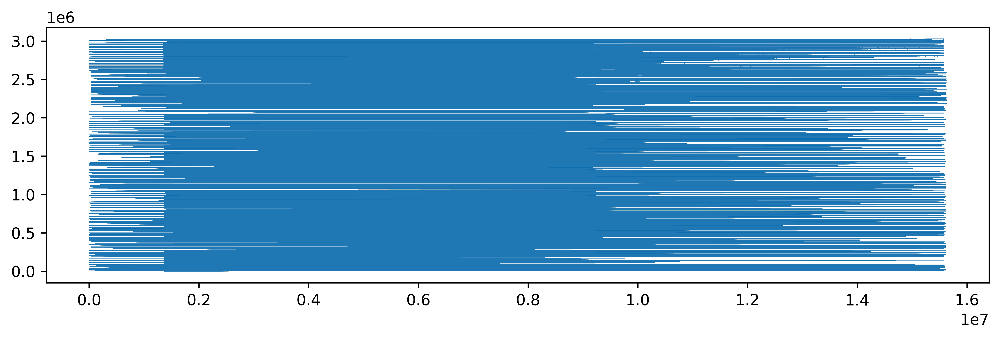

In [73]:
# set size

figure(figsize=(11, 3), dpi=600)

# Plot
vehicle=df['Vehicle'].unique()
for v in vehicle:
    plot_df=df[df['Vehicle']==v]
    plt.plot(df["dist"].cumsum(), marker='', color='#1f77b4', linewidth=0.5, alpha=0.5)


# Remove x-ticks
plt.tick_params(
    axis='x',          # changes apply to the x-axis
    which='both',      # both major and minor ticks are affected
    bottom=False,      # ticks along the bottom edge are off
    top=False,         # ticks along the top edge are off
    labelbottom=False) # labels along the bottom edge are off

# Labelling 

#plt.xlabel("time")
plt.ylabel("Distance (mile)", fontsize=12)
#plt.title("Pandas Time Series Plot")
plt.yticks(fontsize=10)
plt.grid()


# Saving
#plt.savefig(r'../../figures/trajectories-distance.png', dpi=600, bbox_inches='tight')


# Display

plt.show()

In [74]:
#calculating speed by unique vehicle Id and unique day
speed=[]
for i in df.index:
    if i==0 or i==1:
        speed.append(0) 
    else:
        if df['Vehicle'].loc[i]==df['Vehicle'].loc[i-1]:
            if df['Date'].loc[i]==df['Date'].loc[i-1]:
                FMT = '%H:%M:%S'
                time_diff = abs(datetime.strptime(df['time'].loc[i-1], FMT) - datetime.strptime(df['time'].loc[i], FMT)).total_seconds() / 3600.0
                distance = df['dist'].loc[i]
                if time_diff==0:
                    speed.append(0)
                else:
                    speed_current=distance/time_diff
                    speed.append(speed_current) 
                    #if speed_current>=90:
                        #speed.append(90) 
                    #else:    
                        #speed.append(speed_current)
            else:
                #speed.append('nan')
                speed.append(0) 
        else:   
            #speed.append('nan')
            speed.append(0) 
df['speed'] = speed
#df.to_csv(r'../../results/computed-speeds.csv')


for i in range(1,len(df)):
    if df['Date'].loc[i]==df['Date'].loc[i-1]:
        FMT = '%H:%M:%S'
        time_diff = abs(datetime.strptime(df['time'].loc[i-1], FMT) - datetime.strptime(df['time'].loc[i], FMT)).total_seconds() / 3600.0
        distance = df['dist'].loc[i]
        if time_diff==0:
            speed = 0
        else:
            speed = distance / time_diff
        print('Speed:', speed)

TypeError: strptime() argument 1 must be str, not datetime.time

In [ ]:
#calculating acceleration by unique vehicle Id and unique day
acc=[]
for i in df.index:
    if i==0 or i==1 or i==2:
        acc.append(0) 
    else:
        if df['Vehicle'].loc[i]==df['Vehicle'].loc[i-1]:
            if df['Date'].loc[i]==df['Date'].loc[i-1]:
                FMT = '%H:%M:%S'
                time_diff = abs(datetime.strptime(df['time'].loc[i-1], FMT) - datetime.strptime(df['time'].loc[i], FMT)).total_seconds() / 3600.0
                #if df['speed'].loc[i-1]=='nan':
                #    df['speed'].loc[i-1]==0
                #else:
                #    pass
                speed_diff = df['speed'].loc[i] - df['speed'].loc[i-1]
                if time_diff==0:
                    acc.append(0) 
                else:
                    acc_current=(speed_diff/time_diff)*0.00012417777777778 # 1 miles/h2 = 0.00012417777777778 m/s2
                    #if -5<acc_current<5:
                    #    acc.append(acc_current)
                    #else:
                    #    acc.append(0)
                    acc.append(acc_current)
            else:
                #acc.append('nan')
                acc.append(0) 
        else:   
            #acc.append('nan')
            acc.append(0) 
df['acc'] = acc
#df.to_csv(r'../../results/computed-trajectories2.csv')

In [ ]:
# Make a copy of df with calculated trajectories
df_copy=df.copy()

In [ ]:
df_copy

In [ ]:
# Filter data points with time intervals less than 2 seconds and distance greater than 0
df_copy.loc[(df_copy['time_delta_in_seconds'] < 2) & (df_copy['dist'] > 0)]

In [62]:
# Drop rows with time intervals less than 2 seconds and distance greater than 0 (296 rows)
df_copy.drop(df_copy.loc[(df_copy["time_delta_in_seconds"] <2) & (df_copy["dist"] > 0)].index, inplace=True)
df_copy.drop(df_copy.loc[(df_copy["time_delta_in_seconds"] <2) & (df_copy["acc"].abs() > 0)].index, inplace=True)

In [63]:
df_copy

,ServiceDateTime,Unnamed: 0,DateKey,CalendarDate,Year,Month,OpKey,Operator,RtKey,RtKey2,...,Minute,Second,Date,Daytype,time,time_delta,time_delta_in_seconds,dist,speed,acc
0,2022-04-04 06:43:24,112564,8763,2022-04-04 00:00:00.000,2022,4,1,VATCo,3519,1006,...,43,24,2022-04-04,Weekday,06:43:24,NaT,NaN,0.000000,0.000000,0.000000
1,2022-04-04 06:51:27,109326,8763,2022-04-04 00:00:00.000,2022,4,1,VATCo,3513,3380,...,51,27,2022-04-04,Weekday,06:51:27,2023-03-10 00:08:03,483.0,0.627342,0.000000,0.000000
2,2022-04-04 06:51:27,112565,8763,2022-04-04 00:00:00.000,2022,4,1,VATCo,3519,1006,...,51,27,2022-04-04,Weekday,06:51:27,2023-03-10 00:00:00,0.0,0.000000,0.000000,0.000000
3,2022-04-04 06:52:52,109327,8763,2022-04-04 00:00:00.000,2022,4,1,VATCo,3513,3380,...,52,52,2022-04-04,Weekday,06:52:52,2023-03-10 00:01:25,85.0,0.313431,13.274729,0.069816
4,2022-04-04 06:54:33,109328,8763,2022-04-04 00:00:00.000,2022,4,1,VATCo,3513,3380,...,54,33,2022-04-04,Weekday,06:54:33,2023-03-10 00:01:41,101.0,0.421734,15.032101,0.007778
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1361544,2022-04-30 23:54:20,1325566,8789,2022-04-30 00:00:00.000,2022,4,1,VATCo,3515,1001,...,54,20,2022-04-30,Weekend,23:54:20,2023-03-10 00:02:20,140.0,0.254140,6.535024,0.003673
1361545,2022-04-30 23:55:24,1325567,8789,2022-04-30 00:00:00.000,2022,4,1,VATCo,3515,1001,...,55,24,2022-04-30,Weekend,23:55:24,2023-03-10 00:01:04,64.0,0.156799,8.819951,0.015960
1361546,2022-04-30 23:56:47,1325568,8789,2022-04-30 00:00:00.000,2022,4,1,VATCo,3515,1001,...,56,47,2022-04-30,Weekend,23:56:47,2023-03-10 00:01:23,83.0,0.144950,6.286980,-0.013643
1361547,2022-04-30 23:57:32,1325569,8789,2022-04-30 00:00:00.000,2022,4,1,VATCo,3515,1001,...,57,32,2022-04-30,Weekend,23:57:32,2023-03-10 00:00:45,45.0,0.151259,12.100708,0.057755


In [64]:
df_copy.loc[df_copy['acc']>5]

,ServiceDateTime,Unnamed: 0,DateKey,CalendarDate,Year,Month,OpKey,Operator,RtKey,RtKey2,...,Minute,Second,Date,Daytype,time,time_delta,time_delta_in_seconds,dist,speed,acc
13249,2022-04-12 15:00:05,492916,8771,2022-04-12 00:00:00.000,2022,4,2,SATCo,3641,3284,...,0,5,2022-04-12,Weekday,15:00:05,2023-03-10 00:00:02,2.0,0.075489,135.880974,26.716234
14216,2022-04-28 14:58:32,1220646,8787,2022-04-28 00:00:00.000,2022,4,2,SATCo,3641,3284,...,58,32,2022-04-28,Weekday,14:58:32,2023-03-10 00:00:02,2.0,0.075489,135.880974,27.025182
27072,2022-04-20 11:27:27,858458,8779,2022-04-20 00:00:00.000,2022,4,2,SATCo,3647,1088,...,27,27,2022-04-20,Weekday,11:27:27,2023-03-10 00:00:04,4.0,0.058001,52.200869,5.180541
35590,2022-04-12 14:53:05,491234,8771,2022-04-12 00:00:00.000,2022,4,2,SATCo,3631,1104,...,53,5,2022-04-12,Weekday,14:53:05,2023-03-10 00:00:04,4.0,0.101070,90.962783,9.794526
37198,2022-04-21 12:29:02,934677,8780,2022-04-21 00:00:00.000,2022,4,2,SATCo,3655,1099,...,29,2,2022-04-21,Weekday,12:29:02,2023-03-10 00:00:05,5.0,0.095352,68.653784,5.413311
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1336101,2022-04-12 06:00:11,487703,8771,2022-04-12 00:00:00.000,2022,4,1,VATCo,3515,1001,...,0,11,2022-04-12,Weekday,06:00:11,2023-03-10 00:00:11,11.0,0.631544,206.687013,8.399760
1342604,2022-04-12 18:09:02,488979,8771,2022-04-12 00:00:00.000,2022,4,1,VATCo,3515,1001,...,9,2,2022-04-12,Weekday,18:09:02,2023-03-10 00:00:02,2.0,0.071477,128.658003,28.757637
1344396,2022-04-19 09:26:02,799887,8778,2022-04-19 00:00:00.000,2022,4,1,VATCo,3515,1001,...,26,2,2022-04-19,Weekday,09:26:02,2023-03-10 00:00:02,2.0,0.295510,531.918132,118.894341
1346135,2022-04-27 13:00:10,1160508,8786,2022-04-27 00:00:00.000,2022,4,1,VATCo,3410,1007,...,0,10,2022-04-27,Weekday,13:00:10,2023-03-10 00:00:10,10.0,0.631544,227.355715,10.163710


In [65]:
df_copy.loc[df_copy['acc']<-5]

,ServiceDateTime,Unnamed: 0,DateKey,CalendarDate,Year,Month,OpKey,Operator,RtKey,RtKey2,...,Minute,Second,Date,Daytype,time,time_delta,time_delta_in_seconds,dist,speed,acc
262723,2022-04-18 21:51:48,773572,8777,2022-04-18 00:00:00.000,2022,4,2,SATCo,3649,1090,...,51,48,2022-04-18,Weekday,21:51:48,2023-03-10 00:00:03,3.0,0.014083,16.899752,-6.199198
264845,2022-04-24 17:19:35,1044569,8783,2022-04-24 00:00:00.000,2022,4,2,SATCo,3649,1090,...,19,35,2022-04-24,Weekend,17:19:35,2023-03-10 00:00:03,3.0,0.009549,11.459260,-7.042165
388112,2022-04-09 12:19:30,386673,8768,2022-04-09 00:00:00.000,2022,4,2,SATCo,3604,1089,...,19,30,2022-04-09,Weekend,12:19:30,2023-03-10 00:00:13,13.0,0.083751,23.192691,-27.811244
395479,2022-04-25 17:14:24,1095629,8784,2022-04-25 00:00:00.000,2022,4,2,SATCo,3659,1109,...,14,24,2022-04-25,Weekday,17:14:24,2023-03-10 00:00:20,20.0,0.116380,20.948482,-8.772657
640286,2022-04-26 12:15:38,1131489,8785,2022-04-26 00:00:00.000,2022,4,2,SATCo,3650,1092,...,15,38,2022-04-26,Weekday,12:15:38,2023-03-10 00:00:14,14.0,0.864142,222.207890,-34.497416
640287,2022-04-26 12:15:54,1131490,8785,2022-04-26 00:00:00.000,2022,4,2,SATCo,3650,1092,...,15,54,2022-04-26,Weekday,12:15:54,2023-03-10 00:00:16,16.0,0.139823,31.460274,-5.329488
1310835,2022-04-21 23:00:35,902419,8780,2022-04-21 00:00:00.000,2022,4,1,VATCo,3515,1001,...,0,35,2022-04-21,Weekday,23:00:35,2023-03-10 00:00:29,29.0,0.383335,47.586354,-7.360217
1318238,2022-04-30 14:00:23,1324620,8789,2022-04-30 00:00:00.000,2022,4,1,VATCo,3515,1001,...,0,23,2022-04-30,Weekend,14:00:23,2023-03-10 00:00:19,19.0,0.205287,38.896498,-6.571564


In [66]:
df_copy.drop((df_copy.loc[df_copy['acc']>5]).index, inplace=True)

In [67]:
df_copy.drop((df_copy.loc[df_copy['acc']<-5]).index, inplace=True)

In [68]:
# Filter speed greater than 100 mile
df_copy.loc[df_copy['speed']>100]

,ServiceDateTime,Unnamed: 0,DateKey,CalendarDate,Year,Month,OpKey,Operator,RtKey,RtKey2,...,Minute,Second,Date,Daytype,time,time_delta,time_delta_in_seconds,dist,speed,acc
1029334,2022-04-27 08:46:09,1213919,8786,2022-04-27 00:00:00.000,2022,4,3,UMASS,3629,1745,...,46,9,2022-04-27,Weekday,08:46:09,2023-03-10 00:00:16,16.0,0.528266,118.859877,3.320945
1188511,2022-04-18 11:02:55,797011,8777,2022-04-18 00:00:00.000,2022,4,3,UMASS,3626,1734,...,2,55,2022-04-18,Weekday,11:02:55,2023-03-10 00:00:17,17.0,0.891112,188.706041,4.962303
1218924,2022-04-14 09:22:37,640736,8773,2022-04-14 00:00:00.000,2022,4,3,UMASS,3625,1733,...,22,37,2022-04-14,Weekday,09:22:37,2023-03-10 00:00:10,10.0,0.279153,100.494920,4.492525
1245333,2022-04-30 00:40:10,1359890,8789,2022-04-30 00:00:00.000,2022,4,3,UMASS,3626,1734,...,40,10,2022-04-30,Weekend,00:40:10,2023-03-10 00:00:12,12.0,0.336335,100.900415,3.758877
1290725,2022-04-09 14:36:04,379674,8768,2022-04-09 00:00:00.000,2022,4,1,VATCo,3517,1004,...,36,4,2022-04-09,Weekend,14:36:04,2023-03-10 00:01:04,64.0,2.001135,112.563864,0.786259
1292950,2022-04-27 14:00:28,1163637,8786,2022-04-27 00:00:00.000,2022,4,1,VATCo,3518,1005,...,0,28,2022-04-27,Weekday,14:00:28,2023-03-10 00:00:28,28.0,0.826083,106.210649,1.695729
1293856,2022-04-01 13:28:01,3332,8760,2022-04-01 00:00:00.000,2022,4,1,VATCo,3518,1005,...,28,1,2022-04-01,Weekday,13:28:01,2023-03-10 00:01:01,61.0,1.958936,115.609339,0.847246
1297706,2022-04-29 13:00:17,1268766,8788,2022-04-29 00:00:00.000,2022,4,1,VATCo,3410,1007,...,0,17,2022-04-29,Weekday,13:00:17,2023-03-10 00:00:17,17.0,0.631544,133.738656,3.516855
1301663,2022-04-30 08:00:12,1325764,8789,2022-04-30 00:00:00.000,2022,4,1,VATCo,3517,1004,...,0,12,2022-04-30,Weekend,08:00:12,2023-03-10 00:00:12,12.0,0.412466,123.739861,4.609722
1306678,2022-04-30 18:00:32,1325060,8789,2022-04-30 00:00:00.000,2022,4,1,VATCo,3515,1001,...,0,32,2022-04-30,Weekend,18:00:32,2023-03-10 00:00:32,32.0,1.075548,120.999113,1.690358


In [69]:
df_copy.drop((df_copy.loc[df_copy['speed']>100]).index, inplace=True)

In [70]:
df_copy

,ServiceDateTime,Unnamed: 0,DateKey,CalendarDate,Year,Month,OpKey,Operator,RtKey,RtKey2,...,Minute,Second,Date,Daytype,time,time_delta,time_delta_in_seconds,dist,speed,acc
0,2022-04-04 06:43:24,112564,8763,2022-04-04 00:00:00.000,2022,4,1,VATCo,3519,1006,...,43,24,2022-04-04,Weekday,06:43:24,NaT,NaN,0.000000,0.000000,0.000000
1,2022-04-04 06:51:27,109326,8763,2022-04-04 00:00:00.000,2022,4,1,VATCo,3513,3380,...,51,27,2022-04-04,Weekday,06:51:27,2023-03-10 00:08:03,483.0,0.627342,0.000000,0.000000
2,2022-04-04 06:51:27,112565,8763,2022-04-04 00:00:00.000,2022,4,1,VATCo,3519,1006,...,51,27,2022-04-04,Weekday,06:51:27,2023-03-10 00:00:00,0.0,0.000000,0.000000,0.000000
3,2022-04-04 06:52:52,109327,8763,2022-04-04 00:00:00.000,2022,4,1,VATCo,3513,3380,...,52,52,2022-04-04,Weekday,06:52:52,2023-03-10 00:01:25,85.0,0.313431,13.274729,0.069816
4,2022-04-04 06:54:33,109328,8763,2022-04-04 00:00:00.000,2022,4,1,VATCo,3513,3380,...,54,33,2022-04-04,Weekday,06:54:33,2023-03-10 00:01:41,101.0,0.421734,15.032101,0.007778
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1361544,2022-04-30 23:54:20,1325566,8789,2022-04-30 00:00:00.000,2022,4,1,VATCo,3515,1001,...,54,20,2022-04-30,Weekend,23:54:20,2023-03-10 00:02:20,140.0,0.254140,6.535024,0.003673
1361545,2022-04-30 23:55:24,1325567,8789,2022-04-30 00:00:00.000,2022,4,1,VATCo,3515,1001,...,55,24,2022-04-30,Weekend,23:55:24,2023-03-10 00:01:04,64.0,0.156799,8.819951,0.015960
1361546,2022-04-30 23:56:47,1325568,8789,2022-04-30 00:00:00.000,2022,4,1,VATCo,3515,1001,...,56,47,2022-04-30,Weekend,23:56:47,2023-03-10 00:01:23,83.0,0.144950,6.286980,-0.013643
1361547,2022-04-30 23:57:32,1325569,8789,2022-04-30 00:00:00.000,2022,4,1,VATCo,3515,1001,...,57,32,2022-04-30,Weekend,23:57:32,2023-03-10 00:00:45,45.0,0.151259,12.100708,0.057755


In [71]:
df_copy.to_csv(r'../../results/computed-trajectories2.csv')

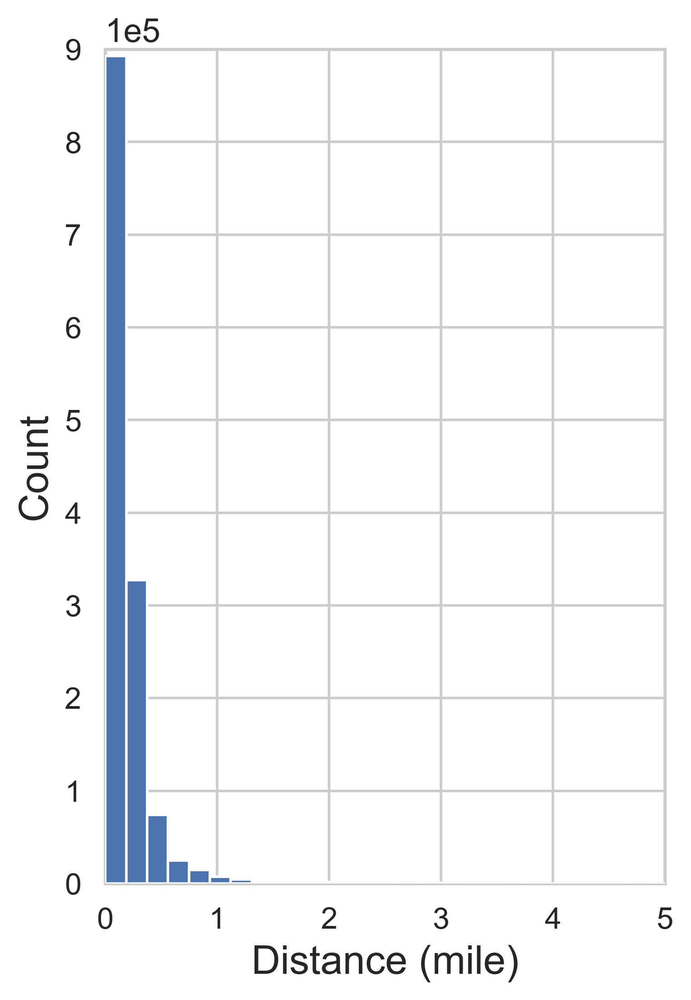

In [72]:
figure(figsize=(4 , 6), dpi=400)
ax=df_copy['dist'].hist(bins=100, zorder=3)
ax.set_xlabel('Distance (mile)', fontsize=16)
ax.set_ylabel('Count', fontsize=16)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.xlim(0,5)
plt.ylim(0,900000)
plt.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
plt.savefig(r'../../figures/hist-trajectories-distance.png', dpi=400, bbox_inches='tight')

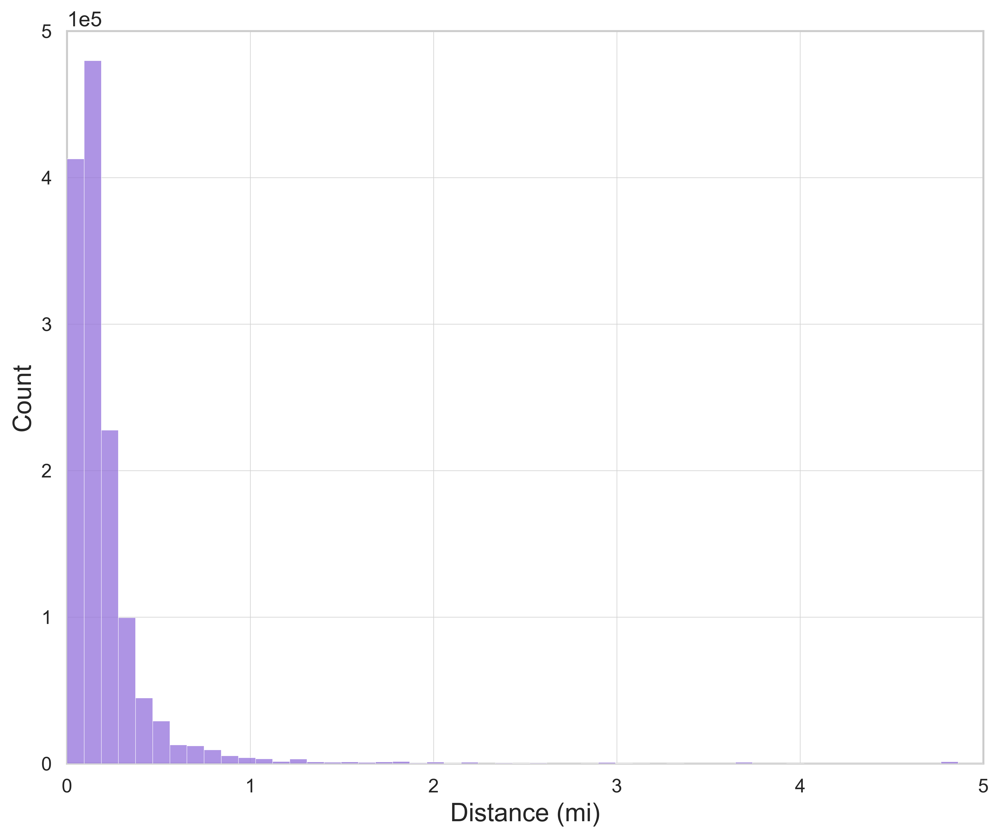

In [141]:
fig = plt.figure(figsize=(10 , 8), dpi=600)


# set style and font size
sns.set(style='whitegrid', font_scale=1.2)

# create histogram with curve
ax=sns.histplot(df_copy['dist'], 
             bins=200, 
             color='mediumpurple',
             zorder=3)  # use the purple color for the histogram

plt.xlabel('Distance (mi)', fontsize=16)
plt.ylabel('Count', fontsize=16)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.xlim(0,5)
plt.ylim(0,500000)
plt.ticklabel_format(style='sci', axis='y', scilimits=(0,0))


# add gridlines
plt.grid(color='lightgrey', linewidth=0.4)



# adjust size and spacing
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1)

# save figure
fig.savefig(r'../../figures/hist-trajectories-distance.png', dpi=600, bbox_inches='tight')


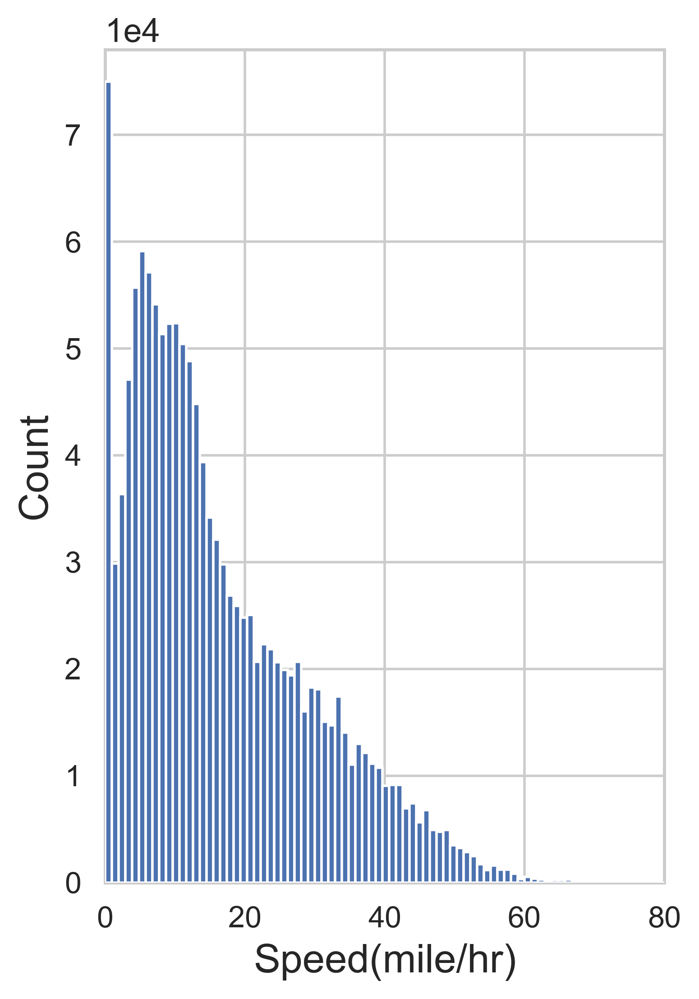

In [74]:
figure(figsize=(4 , 6), dpi=400)
ax=df_copy['speed'].hist(bins=100, zorder=3)
ax.set_xlabel('Speed(mile/hr)', fontsize=16)
ax.set_ylabel('Count', fontsize=16)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.xlim(0,80)
plt.ylim(0,78000)
plt.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
plt.savefig(r'../../figures/hist-trajectories-speed.png', dpi=400, bbox_inches='tight')

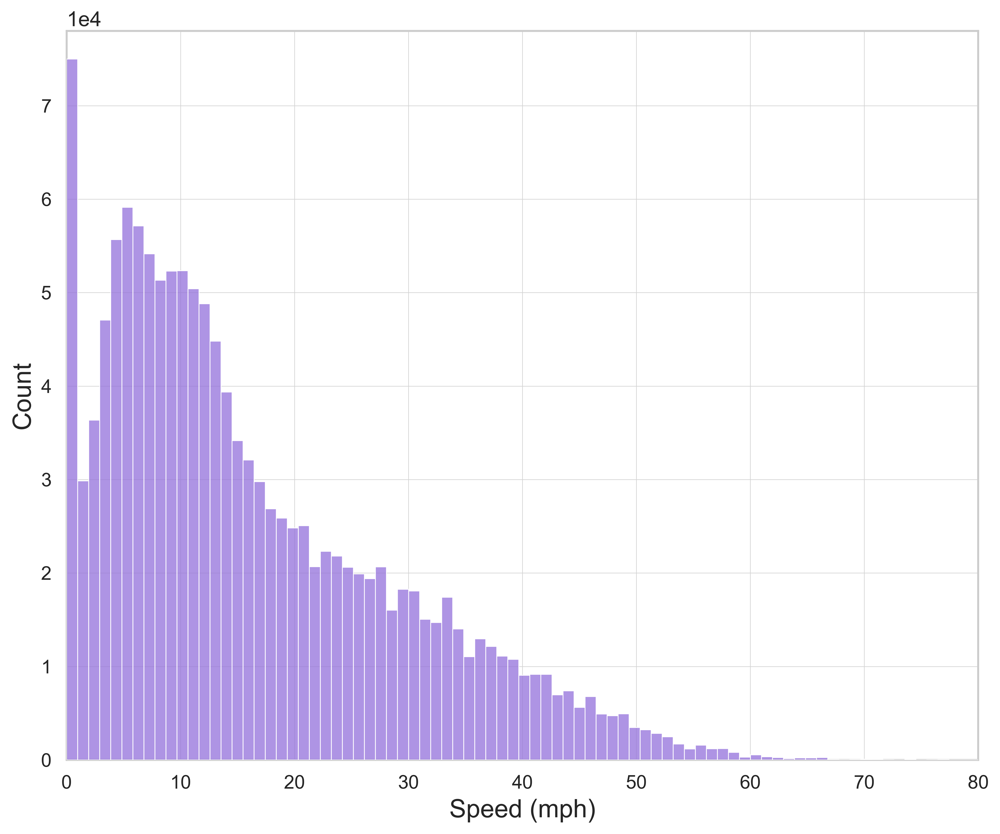

In [140]:
fig = plt.figure(figsize=(10 , 8), dpi=600)


# set style and font size
sns.set(style='whitegrid', font_scale=1.2)

# create histogram with curve
ax=sns.histplot(df_copy['speed'], 
             bins=100, 
             color='mediumpurple',
             zorder=3)  # use the purple color for the histogram

plt.xlabel('Speed (mph)', fontsize=16)
plt.ylabel('Count', fontsize=16)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.xlim(0,80)
plt.ylim(0,78000)
plt.ticklabel_format(style='sci', axis='y', scilimits=(0,0))



# add gridlines
plt.grid(color='lightgrey', linewidth=0.4)


# adjust size and spacing
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1)

# save figure
plt.savefig(r'../../figures/hist-trajectories-speed.png', dpi=400, bbox_inches='tight')


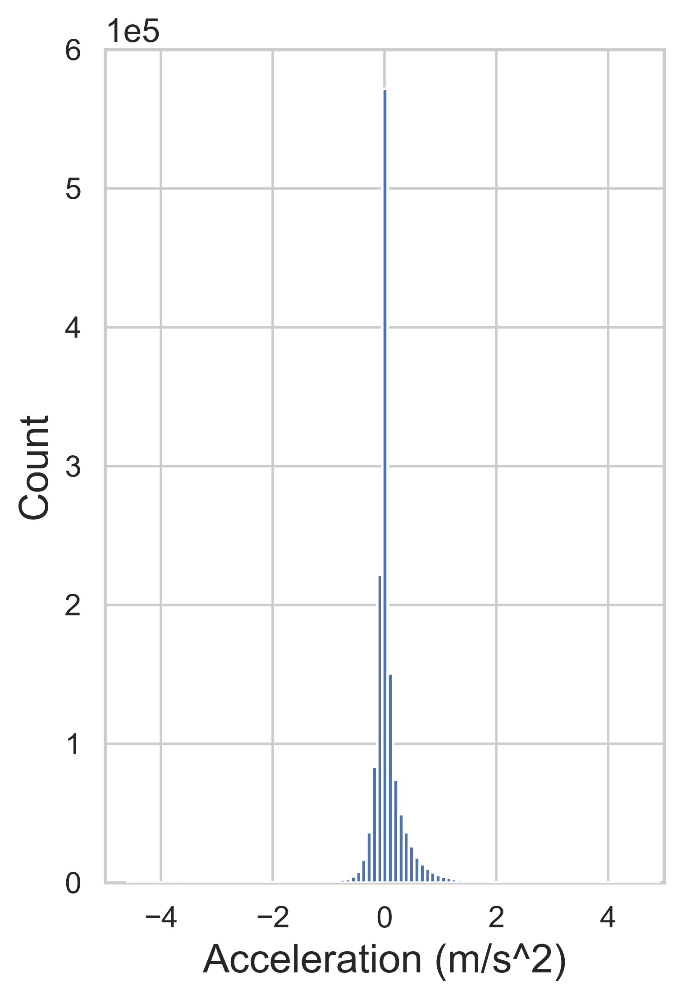

In [76]:
figure(figsize=(4, 6), dpi=400)
ax=df_copy['acc'].hist(bins=100, zorder=3)
ax.set_xlabel('Acceleration (m/s^2)', fontsize=16)
ax.set_ylabel('Count', fontsize=16)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.xlim(-5,5)
plt.ylim(0,600000)
plt.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
plt.savefig(r'../../figures/hist-trajectories-acceleration.png', dpi=400, bbox_inches='tight')

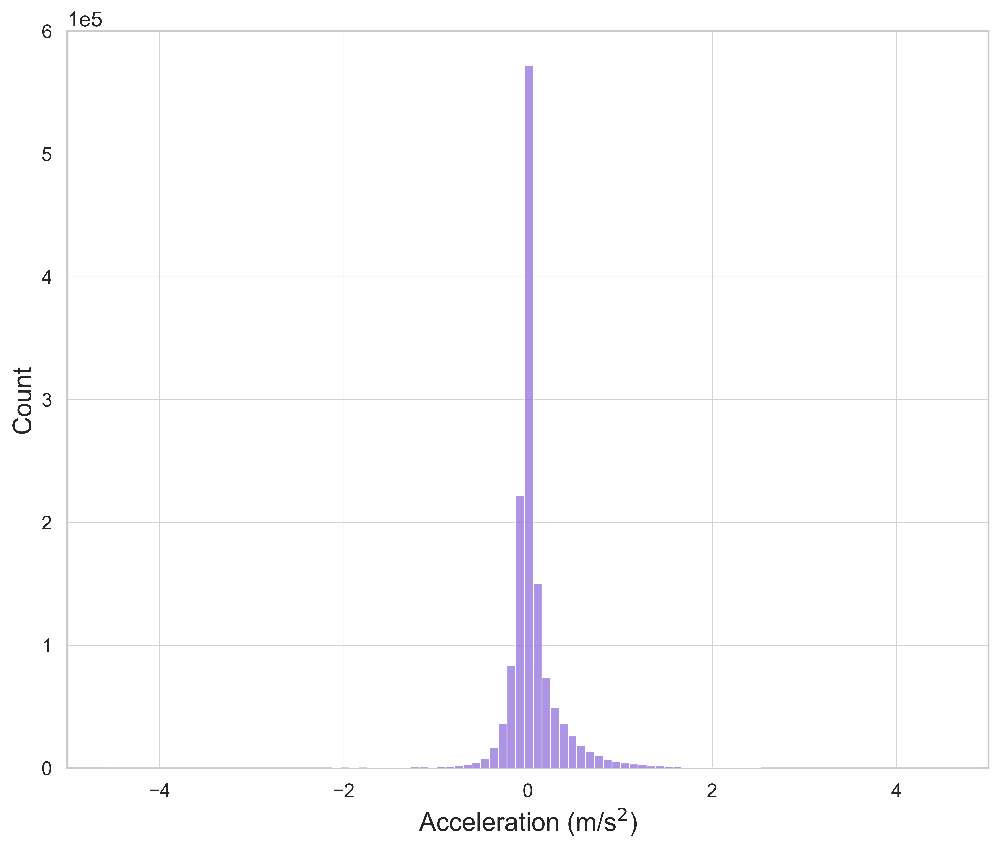

In [139]:
fig = plt.figure(figsize=(10 , 8), dpi=600)


# set style and font size
sns.set(style='whitegrid', font_scale=1.2)

# create histogram with curve
ax=sns.histplot(df_copy['acc'], 
             bins=100, 
             color='mediumpurple',
             zorder=3)  # use the purple color for the histogram

plt.xlabel(r'Acceleration (m/s$^2$)', fontsize=16)
plt.ylabel('Count', fontsize=16)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.xlim(-5,5)
plt.ylim(0,600000)
plt.ticklabel_format(style='sci', axis='y', scilimits=(0,0))



# add gridlines
plt.grid(color='lightgrey', linewidth=0.4)


# adjust size and spacing
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1)

# save figure
plt.savefig(r'../../figures/hist-trajectories-acceleration.png', dpi=400, bbox_inches='tight')


In [78]:
ind_list = [13248, 13249,14215,14216,35589,35590,190041,190042,217628,217629,263794,263795,264966,264967,306983,306984,388110,388111,392564,392565,395360,395361,395477,395478,640284,640285,640286,749057,749058,822527,822528]
df_copy[['ServiceDateTime','Date','Vehicle','dist','speed','acc']].iloc[ind_list]

,ServiceDateTime,Date,Vehicle,dist,speed,acc
13256,2022-04-12 15:04:57,2022-04-12,1412,0.072887,23.853890,0.621677
13257,2022-04-12 15:05:39,2022-04-12,1412,0.136468,11.697265,-0.129393
14224,2022-04-28 15:03:09,2022-04-28,1413,0.136468,11.982564,-0.089424
14225,2022-04-28 15:03:09,2022-04-28,1413,0.000000,0.000000,0.000000
35603,2022-04-13 06:28:08,2022-04-13,1552,0.522519,33.001188,0.116448
35604,2022-04-13 06:29:17,2022-04-13,1552,0.540296,28.189333,-0.031175
190104,2022-04-15 05:15:07,2022-04-15,1652,0.079310,35.689679,0.732855
190105,2022-04-15 05:16:09,2022-04-15,1652,0.246068,14.287840,-0.154314
217708,2022-04-28 11:14:39,2022-04-28,1654,0.332342,33.234249,0.147061
217709,2022-04-28 11:15:28,2022-04-28,1654,0.235301,17.287420,-0.145487


In [81]:
len(df_copy['Route'].unique())

49

In [302]:
len(df_copy['Operator'].unique())

3

In [303]:
df_copy.columns

Index(['ServiceDateTime', 'Unnamed: 0', 'DateKey', 'CalendarDate', 'Year',
       'Month', 'OpKey', 'Operator', 'RtKey', 'RtKey2', 'Route', 'RouteName',
       'TripKey', 'Trip', 'StopKey', 'Stop', 'StopName', 'Lat', 'Lon',
       'Vehicle', 'VehicleType', 'SeatedCap', 'TotalCap', 'Boards', 'Alights',
       'Onboard', 'Bike', 'Wheelchair', 'Weekday', 'Hour', 'Minute', 'Second',
       'Date', 'Daytype', 'time', 'time_delta', 'time_delta_in_seconds',
       'dist', 'speed', 'acc'],
      dtype='object')

In [304]:
len(df_copy['Stop'].unique())

1849

In [305]:
df_copy['Route'].unique()

array(['R44', '(X) 39E', 'B43', '9999', '(X) P11', 'X92', '(X) 821',
       '(X) 804', '(X) 892', '(X) 823', '(X) 801', '(X) 820', 'G5',
       '(X) 802', 'X90', 'B4', 'R14', 'R10', 'G1', 'R29', 'B17', 'G3',
       '(X) 805', '(X) 824', '921', '(X) 803', 'G73', 'P20', 'P21', 'B6',
       'B7', 'G2', 'B12', '(X) 806', '(X) B9', 'B23', 'R24', '31', '30',
       '(X) 38', '33', '46', '45', '35', '(X) 34', 'R41', 'R42', 'B48',
       '(X) 943'], dtype=object)

In [82]:
trajectories = pd.read_csv(r'../../results/computed-trajectories2.csv', delimiter=',', skiprows=0, low_memory=False)

In [83]:
len(trajectories['Vehicle'].unique())

178

In [84]:
trajectories['ServiceDateTime']= pd.to_datetime(trajectories['ServiceDateTime'])

In [85]:
trajectories = trajectories.set_index("ServiceDateTime")
trajectories

,Unnamed: 0.1,Unnamed: 0,DateKey,CalendarDate,Year,Month,OpKey,Operator,RtKey,RtKey2,...,Minute,Second,Date,Daytype,time,time_delta,time_delta_in_seconds,dist,speed,acc
ServiceDateTime,,,,,,,,,,,,,,,,,,,,,
2022-04-04 06:43:24,0,112564,8763,2022-04-04 00:00:00.000,2022,4,1,VATCo,3519,1006,...,43,24,2022-04-04,Weekday,06:43:24,NaN,NaN,0.000000,0.000000,0.000000
2022-04-04 06:51:27,1,109326,8763,2022-04-04 00:00:00.000,2022,4,1,VATCo,3513,3380,...,51,27,2022-04-04,Weekday,06:51:27,2023-03-10 00:08:03,483.0,0.627342,0.000000,0.000000
2022-04-04 06:51:27,2,112565,8763,2022-04-04 00:00:00.000,2022,4,1,VATCo,3519,1006,...,51,27,2022-04-04,Weekday,06:51:27,2023-03-10 00:00:00,0.0,0.000000,0.000000,0.000000
2022-04-04 06:52:52,3,109327,8763,2022-04-04 00:00:00.000,2022,4,1,VATCo,3513,3380,...,52,52,2022-04-04,Weekday,06:52:52,2023-03-10 00:01:25,85.0,0.313431,13.274729,0.069816
2022-04-04 06:54:33,4,109328,8763,2022-04-04 00:00:00.000,2022,4,1,VATCo,3513,3380,...,54,33,2022-04-04,Weekday,06:54:33,2023-03-10 00:01:41,101.0,0.421734,15.032101,0.007778
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-04-30 23:54:20,1361544,1325566,8789,2022-04-30 00:00:00.000,2022,4,1,VATCo,3515,1001,...,54,20,2022-04-30,Weekend,23:54:20,2023-03-10 00:02:20,140.0,0.254140,6.535024,0.003673
2022-04-30 23:55:24,1361545,1325567,8789,2022-04-30 00:00:00.000,2022,4,1,VATCo,3515,1001,...,55,24,2022-04-30,Weekend,23:55:24,2023-03-10 00:01:04,64.0,0.156799,8.819951,0.015960
2022-04-30 23:56:47,1361546,1325568,8789,2022-04-30 00:00:00.000,2022,4,1,VATCo,3515,1001,...,56,47,2022-04-30,Weekend,23:56:47,2023-03-10 00:01:23,83.0,0.144950,6.286980,-0.013643


In [86]:
selected_date=['2022-04-04']
plot_data=trajectories.loc[trajectories.Date.isin(selected_date)]

In [87]:
plot_data.columns

Index(['Unnamed: 0.1', 'Unnamed: 0', 'DateKey', 'CalendarDate', 'Year',
       'Month', 'OpKey', 'Operator', 'RtKey', 'RtKey2', 'Route', 'RouteName',
       'TripKey', 'Trip', 'StopKey', 'Stop', 'StopName', 'Lat', 'Lon',
       'Vehicle', 'VehicleType', 'SeatedCap', 'TotalCap', 'Boards', 'Alights',
       'Onboard', 'Bike', 'Wheelchair', 'Weekday', 'Hour', 'Minute', 'Second',
       'Date', 'Daytype', 'time', 'time_delta', 'time_delta_in_seconds',
       'dist', 'speed', 'acc'],
      dtype='object')

In [312]:
plot_data['Operator'].unique()

array(['VATCo', 'SATCo', 'UMASS'], dtype=object)

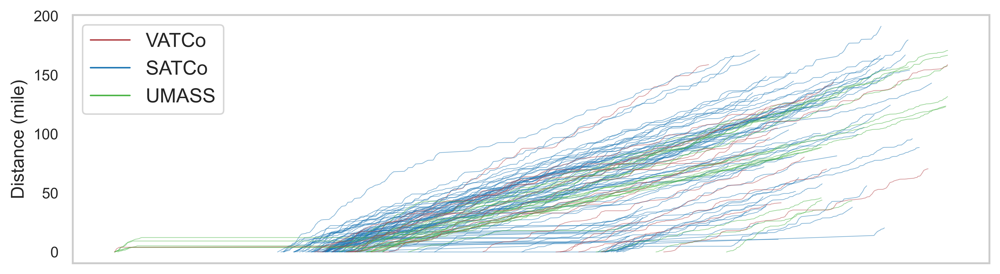

In [313]:
# set size

figure(figsize=(11, 3), dpi=600)

# Plot
vehicle=plot_data['Vehicle'].unique()
for v in vehicle:
    plot_df=plot_data[plot_data['Vehicle']==v]
    operator=plot_df.iloc[1]['Operator']
    if operator=='VATCo':
        plt.plot(plot_df["dist"].cumsum(), marker='', c='#B4464B', linewidth=0.5, alpha=0.5)
    elif operator=='SATCo':
        plt.plot(plot_df["dist"].cumsum(), marker='', c='#1f77b4', linewidth=0.5, alpha=0.5)
    else:
        plt.plot(plot_df["dist"].cumsum(), marker='', c='#4BB446', linewidth=0.5, alpha=0.5)


# Remove x-ticks
plt.tick_params(
    axis='x',          # changes apply to the x-axis
    which='both',      # both major and minor ticks are affected
    bottom=False,      # ticks along the bottom edge are off
    top=False,         # ticks along the top edge are off
    labelbottom=False) # labels along the bottom edge are off

# Labelling 
#plt.xlabel("time")
plt.ylabel("Distance (mile)", fontsize=12)
#plt.title("Pandas Time Series Plot")
plt.yticks(fontsize=10)
plt.grid()


# Legend
custom_lines = [Line2D([0], [0], color='#B4464B', lw=1),
                Line2D([0], [0], color='#1f77b4', lw=1),
                Line2D([0], [0], color='#4BB446', lw=1)]
plt.legend(custom_lines, ['VATCo', 'SATCo', 'UMASS'])


# Saving
#plt.savefig(r'../../figures/trajectories-distance.png', dpi=600, bbox_inches='tight')


# Display

plt.show()

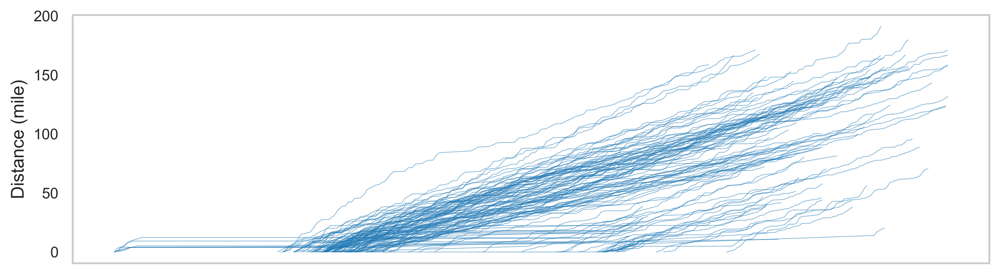

In [314]:
# set size

figure(figsize=(11, 3), dpi=600)

# Plot
vehicle=plot_data['Vehicle'].unique()
for v in vehicle:
    plot_df=plot_data[plot_data['Vehicle']==v]
    plt.plot(plot_df["dist"].cumsum(), marker='', color='#1f77b4', linewidth=0.5, alpha=0.5)


# Remove x-ticks
plt.tick_params(
    axis='x',          # changes apply to the x-axis
    which='both',      # both major and minor ticks are affected
    bottom=False,      # ticks along the bottom edge are off
    top=False,         # ticks along the top edge are off
    labelbottom=False) # labels along the bottom edge are off

# Labelling 

#plt.xlabel("time")
plt.ylabel("Distance (mile)", fontsize=12)
#plt.title("Pandas Time Series Plot")
plt.yticks(fontsize=10)
plt.grid()


# Saving
#plt.savefig(r'../../figures/trajectories-distance.png', dpi=600, bbox_inches='tight')


# Display

plt.show()

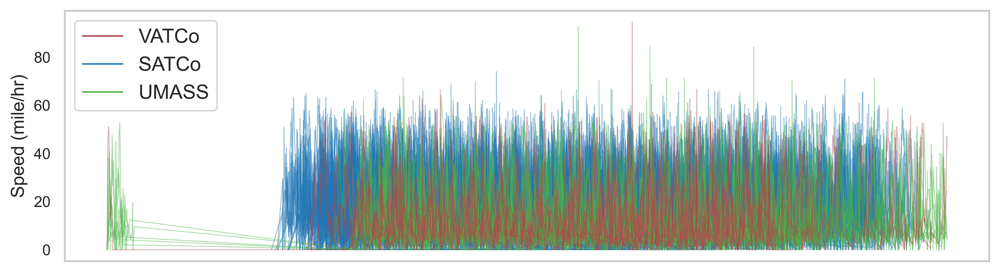

In [315]:
# set size

figure(figsize=(11, 3), dpi=600)

# Plot
vehicle=plot_data['Vehicle'].unique()
for v in vehicle:
    plot_df=plot_data[plot_data['Vehicle']==v]
    operator=plot_df.iloc[1]['Operator']
    if operator=='VATCo':
        plt.plot(plot_df["speed"], marker='',color='#B4464B', linewidth=0.5, alpha=0.5)
    elif operator=='SATCo':
        plt.plot(plot_df["speed"], marker='',color='#1f77b4', linewidth=0.5, alpha=0.5)
    else:
        plt.plot(plot_df["speed"], marker='',color='#4BB446', linewidth=0.5, alpha=0.5)        


# Remove x-ticks
plt.tick_params(
    axis='x',          # changes apply to the x-axis
    which='both',      # both major and minor ticks are affected
    bottom=False,      # ticks along the bottom edge are off
    top=False,         # ticks along the top edge are off
    labelbottom=False) # labels along the bottom edge are off

# Labelling 

#plt.xlabel("time")
plt.ylabel("Speed (mile/hr)", fontsize=12)
plt.yticks(fontsize=10)
#plt.title("Pandas Time Series Plot")
plt.grid()

# Legend
custom_lines = [Line2D([0], [0], color='#B4464B', lw=1),
                Line2D([0], [0], color='#1f77b4', lw=1),
                Line2D([0], [0], color='#4BB446', lw=1)]
plt.legend(custom_lines, ['VATCo', 'SATCo', 'UMASS'])

# Saving
plt.savefig(r'../../figures/trajectories-speed.png', dpi=600, bbox_inches='tight')

# Display

plt.show()

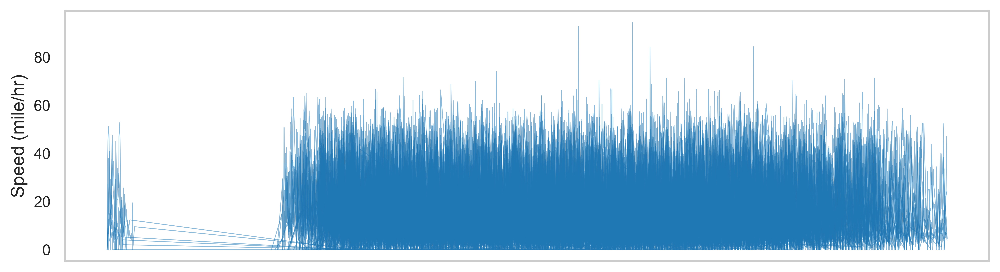

In [316]:
# set size

figure(figsize=(11, 3), dpi=600)

# Plot
vehicle=plot_data['Vehicle'].unique()
for v in vehicle:
    plot_df=plot_data[plot_data['Vehicle']==v]
    plt.plot(plot_df["speed"], marker='',color='#1f77b4', linewidth=0.5, alpha=0.5)



# Remove x-ticks
plt.tick_params(
    axis='x',          # changes apply to the x-axis
    which='both',      # both major and minor ticks are affected
    bottom=False,      # ticks along the bottom edge are off
    top=False,         # ticks along the top edge are off
    labelbottom=False) # labels along the bottom edge are off

# Labelling 

#plt.xlabel("time")
plt.ylabel("Speed (mile/hr)", fontsize=12)
plt.yticks(fontsize=10)
#plt.title("Pandas Time Series Plot")
plt.grid()



# Saving
#plt.savefig(r'../../figures/trajectories-speed.png', dpi=600, bbox_inches='tight')

# Display

plt.show()

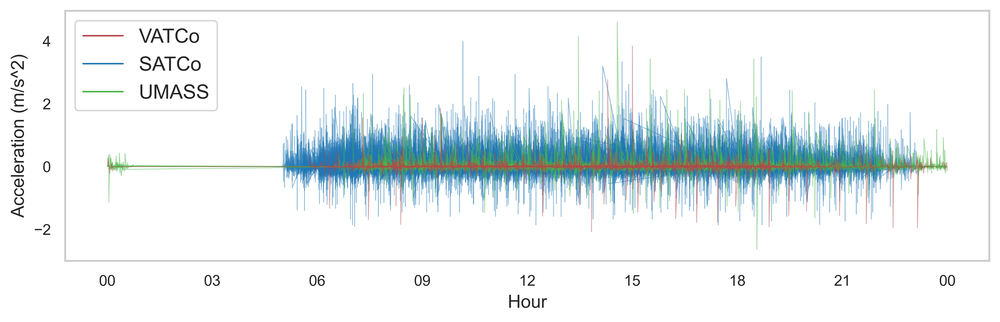

In [317]:
# set size
fig, ax = plt.subplots(figsize=(11, 3), dpi=600)
#figure(figsize=(11, 4), dpi=400)

# Plot
vehicle=plot_data['Vehicle'].unique()
for v in vehicle:
    plot_df=plot_data[plot_data['Vehicle']==v]
    operator=plot_df.iloc[1]['Operator']
    if operator=='VATCo':  
        plt.plot(plot_df["acc"], marker='', color='#B4464B', linewidth=0.5, alpha=0.5)
    elif operator=='SATCo':
        plt.plot(plot_df["acc"], marker='', color='#1f77b4', linewidth=0.5, alpha=0.5)
    else:
        plt.plot(plot_df["acc"], marker='', color='#4BB446', linewidth=0.5, alpha=0.5)


# Labelling 

#plt.xlabel("time")
plt.ylabel("Acceleration (m/s^2)", fontsize=12)
plt.xlabel("Hour", fontsize=12)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
#plt.title("Pandas Time Series Plot")
plt.grid()

date_form = DateFormatter("%H")
ax.xaxis.set_major_formatter(date_form)


# Legend
custom_lines = [Line2D([0], [0], color='#B4464B', lw=1),
                Line2D([0], [0], color='#1f77b4', lw=1),
                Line2D([0], [0], color='#4BB446', lw=1)]
plt.legend(custom_lines, ['VATCo', 'SATCo', 'UMASS'])



# Saving
plt.savefig(r'../../figures/trajectories-acceleration.png', dpi=600, bbox_inches='tight')

# Display

plt.show()

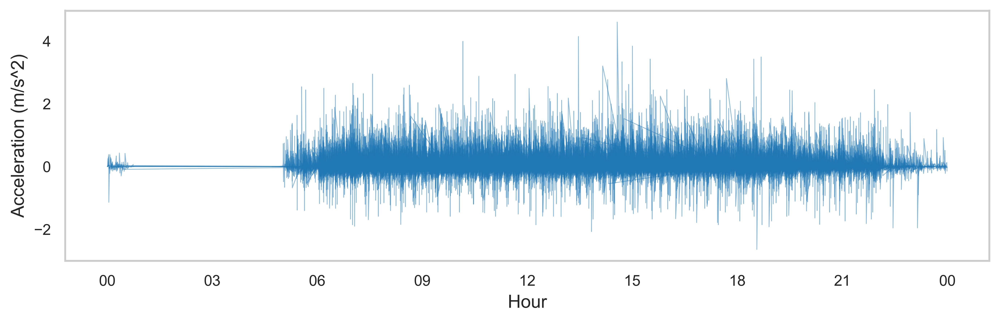

In [318]:
# set size
fig, ax = plt.subplots(figsize=(11, 3), dpi=600)
#figure(figsize=(11, 4), dpi=400)

# Plot
vehicle=plot_data['Vehicle'].unique()
for v in vehicle:
    plot_df=plot_data[plot_data['Vehicle']==v]
    plt.plot(plot_df["acc"], marker='', color='#1f77b4', linewidth=0.5, alpha=0.5)


# Labelling 

#plt.xlabel("time")
plt.ylabel("Acceleration (m/s^2)", fontsize=12)
plt.xlabel("Hour", fontsize=12)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
#plt.title("Pandas Time Series Plot")
plt.grid()

date_form = DateFormatter("%H")
ax.xaxis.set_major_formatter(date_form)

# Saving
#plt.savefig(r'../../figures/trajectories-acceleration.png', dpi=600, bbox_inches='tight')

# Display

plt.show()

In [92]:
trajectories=trajectories.reset_index()
trajectories.head()

,ServiceDateTime,Unnamed: 0.1,Unnamed: 0,DateKey,CalendarDate,Year,Month,OpKey,Operator,RtKey,...,Minute,Second,Date,Daytype,time,time_delta,time_delta_in_seconds,dist,speed,acc
0,2022-04-01 00:00:00,1062086,46929,8760,2022-04-01 00:00:00.000,2022,4,3,UMASS,3505,...,0,0,2022-04-01,Weekday,00:00:00,NaN,NaN,0.0,0.0,0.0
1,2022-04-01 00:00:08,1346943,2437,8760,2022-04-01 00:00:00.000,2022,4,1,VATCo,3515,...,0,8,2022-04-01,Weekday,00:00:08,NaN,NaN,0.0,0.0,0.0
2,2022-04-01 00:00:12,1174966,46955,8760,2022-04-01 00:00:00.000,2022,4,3,UMASS,3505,...,0,12,2022-04-01,Weekday,00:00:12,NaN,NaN,0.0,0.0,0.0
3,2022-04-01 00:00:18,1213526,48367,8760,2022-04-01 00:00:00.000,2022,4,3,UMASS,3508,...,0,18,2022-04-01,Weekday,00:00:18,NaN,NaN,0.0,0.0,0.0
4,2022-04-01 00:00:18,1213527,50425,8760,2022-04-01 00:00:00.000,2022,4,3,UMASS,3508,...,0,18,2022-04-01,Weekday,00:00:18,2023-03-10 00:00:00,0.0,0.0,0.0,0.0


In [93]:
trajectories.sort_values(by=['ServiceDateTime','Vehicle'], ascending=True, inplace=True)

In [94]:
trajectories['Vehicle']

0          3303
1          7901
2          3317
3          3322
4          3322
           ... 
1360782    3325
1360783    3301
1360784    7902
1360785    3222
1360786    3325
Name: Vehicle, Length: 1360787, dtype: int64

In [95]:
trajectories['time_delta'] = trajectories.groupby(['Vehicle', 'Date'])['ServiceDateTime'].diff()

In [96]:
trajectories['time_delta'].max()

Timedelta('0 days 20:26:36')

In [97]:
trajectories['time_delta'].median()

Timedelta('0 days 00:00:41')

In [98]:
trajectories['time_delta'].min()

Timedelta('0 days 00:00:00')

In [99]:
trajectories['time_delta'].unique()

array([         'NaT',              0,    17000000000, ...,
       12664000000000,  3338000000000, 56031000000000],
      dtype='timedelta64[ns]')

In [100]:
#trajectories.time_delta=trajectories.time_delta.astype(str).str.replace('0 days ', '')

In [101]:
#trajectories['time_delta']= pd.to_datetime(trajectories['time_delta'])

In [102]:
#trajectories['time_delta_in_seconds'] = trajectories['time_delta'].dt.hour * 3600 + trajectories['time_delta'].dt.minute * 60 + trajectories['time_delta'].dt.second

In [103]:
trajectories['time_delta_in_seconds'].unique()

array([       nan, 0.0000e+00, 1.7000e+01, ..., 1.2664e+04, 3.3380e+03,
       5.6031e+04])

In [104]:
trajectories.head()

,ServiceDateTime,Unnamed: 0.1,Unnamed: 0,DateKey,CalendarDate,Year,Month,OpKey,Operator,RtKey,...,Minute,Second,Date,Daytype,time,time_delta,time_delta_in_seconds,dist,speed,acc
0,2022-04-01 00:00:00,1062086,46929,8760,2022-04-01 00:00:00.000,2022,4,3,UMASS,3505,...,0,0,2022-04-01,Weekday,00:00:00,NaT,NaN,0.0,0.0,0.0
1,2022-04-01 00:00:08,1346943,2437,8760,2022-04-01 00:00:00.000,2022,4,1,VATCo,3515,...,0,8,2022-04-01,Weekday,00:00:08,NaT,NaN,0.0,0.0,0.0
2,2022-04-01 00:00:12,1174966,46955,8760,2022-04-01 00:00:00.000,2022,4,3,UMASS,3505,...,0,12,2022-04-01,Weekday,00:00:12,NaT,NaN,0.0,0.0,0.0
3,2022-04-01 00:00:18,1213526,48367,8760,2022-04-01 00:00:00.000,2022,4,3,UMASS,3508,...,0,18,2022-04-01,Weekday,00:00:18,NaT,NaN,0.0,0.0,0.0
4,2022-04-01 00:00:18,1213527,50425,8760,2022-04-01 00:00:00.000,2022,4,3,UMASS,3508,...,0,18,2022-04-01,Weekday,00:00:18,0 days,0.0,0.0,0.0,0.0


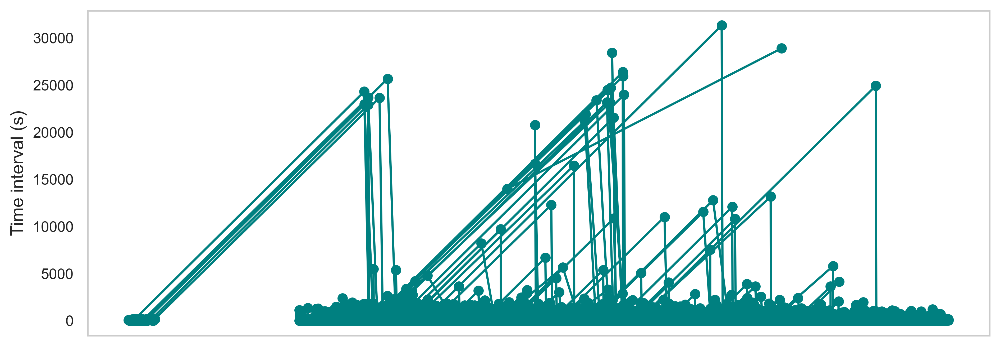

In [332]:
# set size

figure(figsize=(11, 4), dpi=400)

# Plot
vehicle=plot_data['Vehicle'].unique()
for v in vehicle:
    plot_df=plot_data[plot_data['Vehicle']==v]
    plt.plot(plot_df["time_delta_in_seconds"], marker='o', color='teal')



# Remove x-ticks
plt.tick_params(
    axis='x',          # changes apply to the x-axis
    which='both',      # both major and minor ticks are affected
    bottom=False,      # ticks along the bottom edge are off
    top=False,         # ticks along the top edge are off
    labelbottom=False) # labels along the bottom edge are off

# Labelling 

#plt.xlabel("time")
plt.ylabel("Time interval (s)", fontsize=12)
plt.yticks(fontsize=10)
#plt.title("Pandas Time Series Plot")
plt.grid()

# Saving
plt.savefig(r'../../figures/time-intervals.png', dpi=400, bbox_inches='tight')

# Display

plt.show()

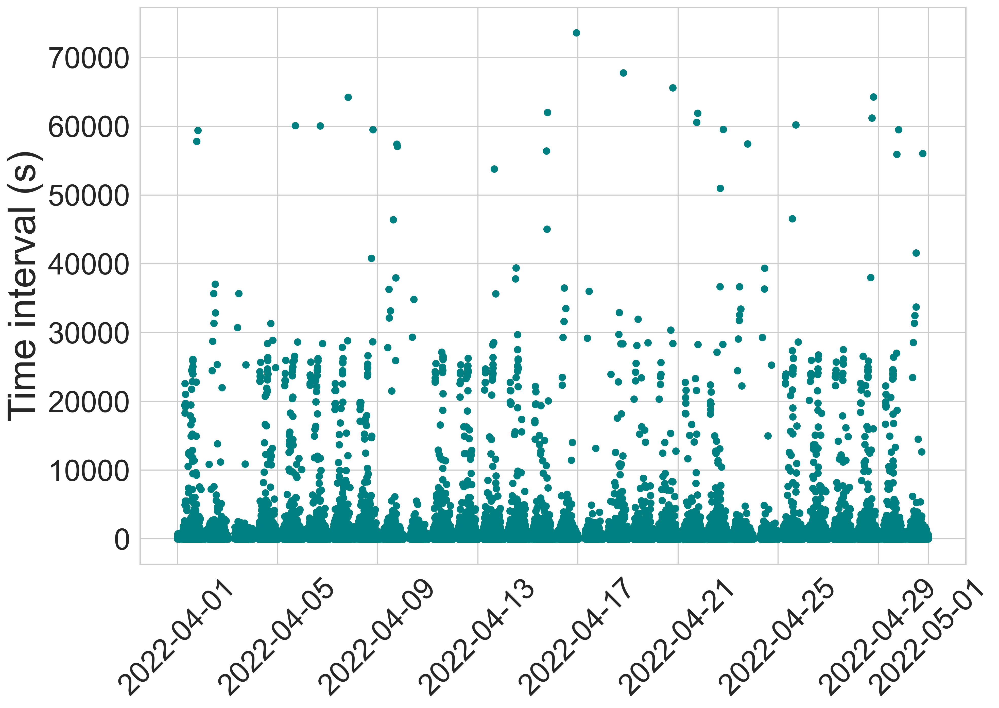

In [333]:
figure(figsize=(14, 9.5), dpi=300)
plt.plot_date(x=trajectories['ServiceDateTime']  , y=trajectories["time_delta_in_seconds"], fmt='o', tz=None, xdate=True, ydate=False, color='teal')
plt.ylabel("Time interval (s)", fontsize=36)
plt.xticks(fontsize=28, rotation = 45)
plt.yticks(fontsize=28)
#plt.savefig(r'../../figures/time-intervals.png', dpi=400, bbox_inches='tight')
plt.show()

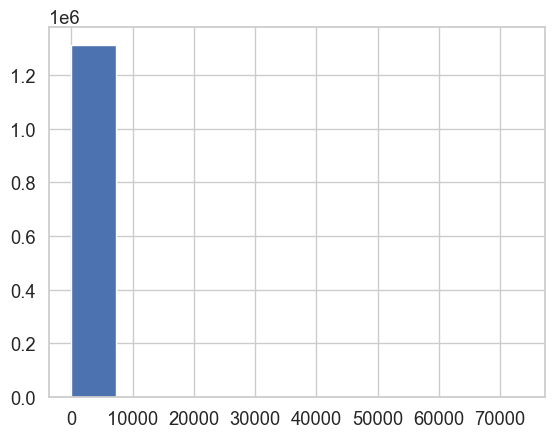

In [106]:
df_time_intervals = trajectories[trajectories['time_delta_in_seconds'] > 0]
plt.hist(df_time_intervals['time_delta_in_seconds'])
#plt.savefig(r'../../figures/hist-time-intervals.png', dpi=400, bbox_inches='tight')
plt.show()

In [110]:
df_time_intervals['time_delta_in_seconds'].min()

1.0

In [120]:
# Calculate the 95th percentile of the column
q = df_time_intervals['time_delta_in_seconds'].quantile(0.97)

# Filter the DataFrame to exclude rows where time_delta_in_seconds is greater than the 95th percentile value
df_filtered = df_time_intervals[df_time_intervals['time_delta_in_seconds'] <= q]

(array([708616., 330678., 125343.,  52837.,  23715.,  11691.,   7342.,
          5749.,   4795.,   4496.]),
 array([  1. ,  47.4,  93.8, 140.2, 186.6, 233. , 279.4, 325.8, 372.2,
        418.6, 465. ]),
 <BarContainer object of 10 artists>)

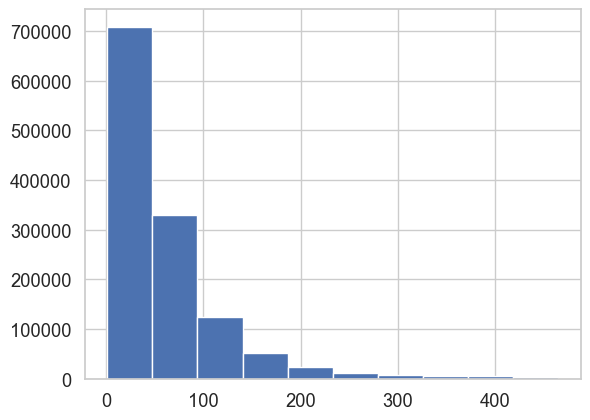

In [121]:
plt.hist(df_filtered['time_delta_in_seconds'])

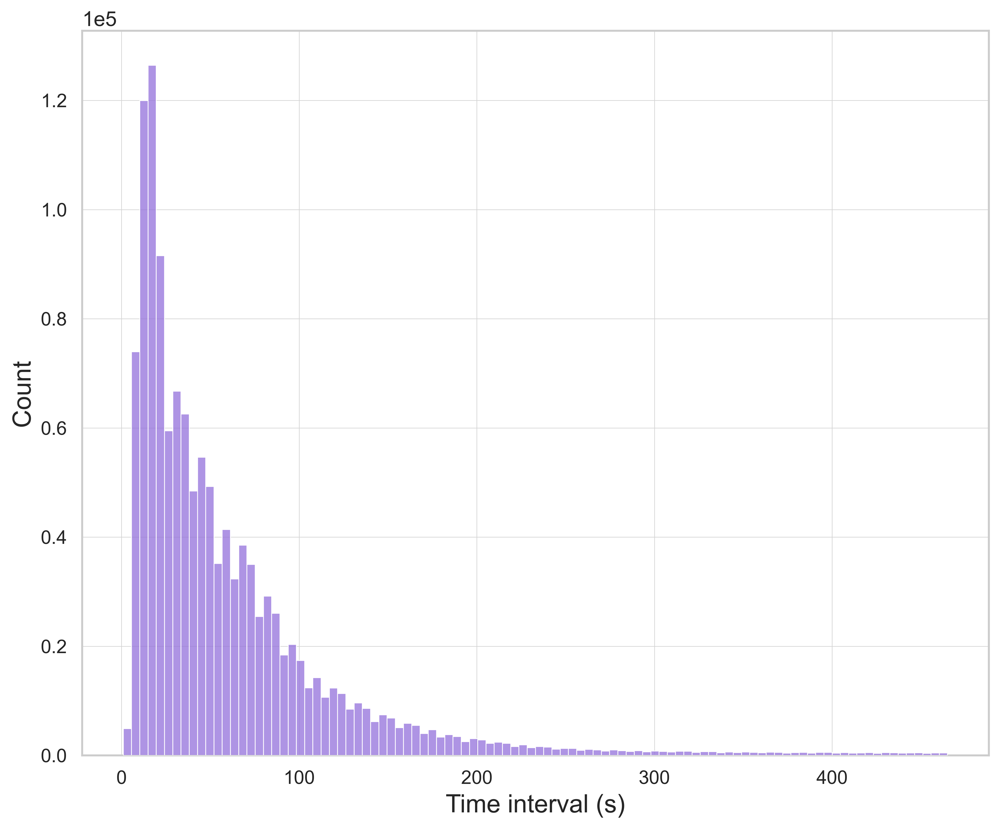

In [142]:
fig = plt.figure(figsize=(10 , 8), dpi=600)


# set style and font size
sns.set(style='whitegrid', font_scale=1.2)

# create histogram with curve
ax=sns.histplot(df_filtered['time_delta_in_seconds'], 
             bins=100, 
             color='mediumpurple',
             zorder=3)  # use the purple color for the histogram

plt.xlabel('Time interval (s)', fontsize=16)
plt.ylabel('Count', fontsize=16)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.ticklabel_format(style='sci', axis='y', scilimits=(0,0))



# add gridlines
plt.grid(color='lightgrey', linewidth=0.4)


# adjust size and spacing
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1)

# save figure
plt.savefig(r'../../figures/hist-trajectories-intervals.png', dpi=400, bbox_inches='tight')


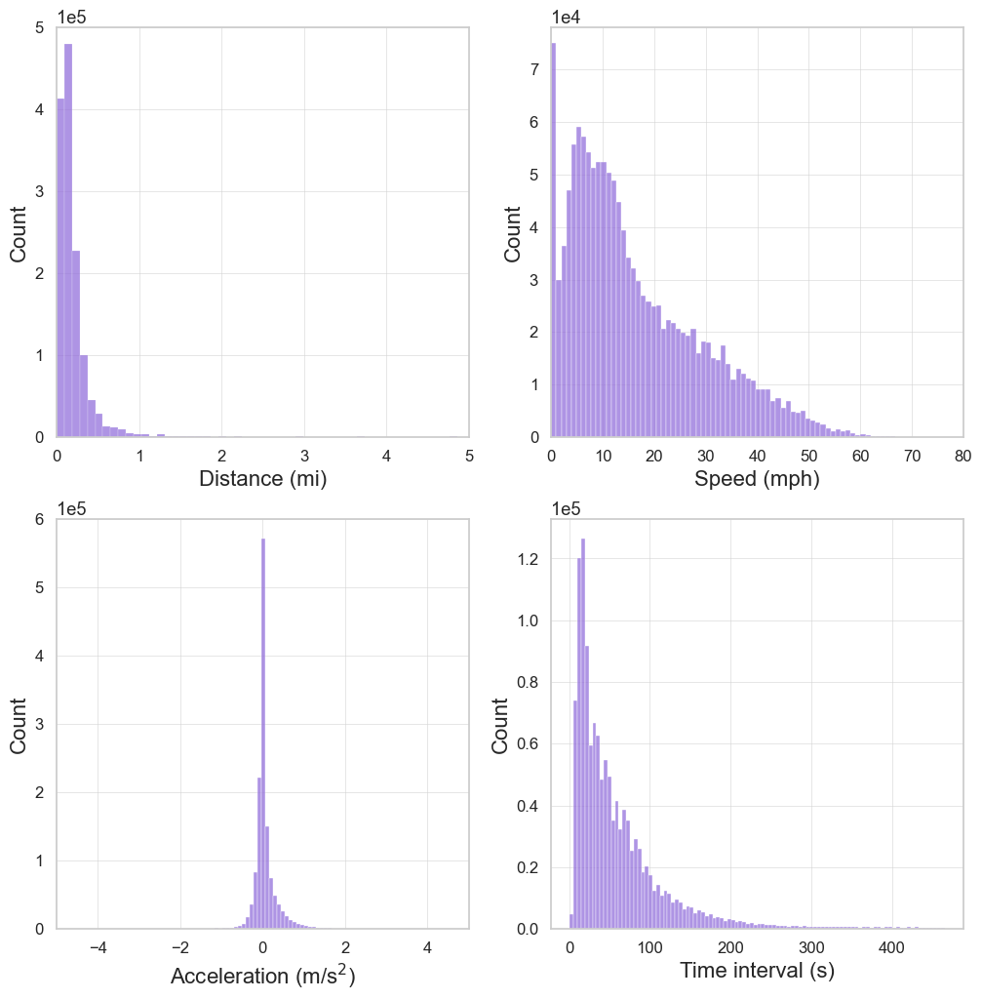

In [160]:
import seaborn as sns
import matplotlib.pyplot as plt

# create a figure with two columns and two rows
fig, axs = plt.subplots(ncols=2, nrows=2, figsize=(12, 12))

# set style and font size
sns.set(style='whitegrid', font_scale=1.2)

# create histogram with curve for each variable
sns.histplot(data=df_copy, x='dist', bins=200, color='mediumpurple', ax=axs[0, 0])
axs[0, 0].set_xlabel('Distance (mi)', fontsize=16)
axs[0, 0].set_ylabel('Count', fontsize=16)
axs[0, 0].tick_params(axis='x', labelsize=12)
axs[0, 0].tick_params(axis='y', labelsize=12)
axs[0, 0].set_xlim(0, 5)
axs[0, 0].set_ylim(0, 500000)
axs[0, 0].ticklabel_format(style='sci', axis='y', scilimits=(0, 0))
axs[0, 0].grid(color='lightgrey', linewidth=0.4)


sns.histplot(data=df_copy, x='speed', bins=100, color='mediumpurple', ax=axs[0, 1])
axs[0, 1].set_xlabel('Speed (mph)', fontsize=16)
axs[0, 1].set_ylabel('Count', fontsize=16)
axs[0, 1].tick_params(axis='x', labelsize=12)
axs[0, 1].tick_params(axis='y', labelsize=12)
axs[0, 1].set_xlim(0, 80)
axs[0, 1].set_ylim(0, 78000)
axs[0, 1].ticklabel_format(style='sci', axis='y', scilimits=(0, 0))
axs[0, 1].grid(color='lightgrey', linewidth=0.4)


sns.histplot(data=df_copy, x='acc', bins=100, color='mediumpurple', ax=axs[1, 0])
axs[1, 0].set_xlabel(r'Acceleration (m/s$^2$)', fontsize=16)
axs[1, 0].set_ylabel('Count', fontsize=16)
axs[1, 0].tick_params(axis='x', labelsize=12)
axs[1, 0].tick_params(axis='y', labelsize=12)
axs[1, 0].set_xlim(-5, 5)
axs[1, 0].set_ylim(0, 600000)
axs[1, 0].ticklabel_format(style='sci', axis='y', scilimits=(0, 0))
axs[1, 0].grid(color='lightgrey', linewidth=0.4)


sns.histplot(data=df_filtered, x='time_delta_in_seconds', bins=100, color='mediumpurple', ax=axs[1, 1])
axs[1, 1].set_xlabel('Time interval (s)', fontsize=16)
axs[1, 1].set_ylabel('Count', fontsize=16)
axs[1, 1].tick_params(axis='x', labelsize=12)
axs[1, 1].tick_params(axis='y', labelsize=12)
#axs[1, 1].set_xlim(-5, 5)
#axs[1, 1].set_ylim(0, 600000)
axs[1, 1].ticklabel_format(style='sci', axis='y', scilimits=(0, 0))
axs[1, 1].grid(color='lightgrey', linewidth=0.4)

# save figure
plt.savefig(r'../../figures/hist-trajectories-facet.png', dpi=600, bbox_inches='tight')

In [163]:
len(df['Route'].unique())

49

In [164]:
#trajectories.to_csv(r'../../results/computed-trajectories-v02.csv')

In [165]:
df_acc = trajectories.sort_values('acc', ascending=False)
df_acc['acc']

400845     4.898797
616374     4.896541
449378     4.896541
611430     4.873627
353589     4.829117
             ...   
1277353         NaN
1278123         NaN
1296554         NaN
1296994         NaN
1297178         NaN
Name: acc, Length: 1360787, dtype: float64

In [166]:
df_dist = trajectories.sort_values('dist', ascending=False)
df_dist['dist']

787722     18.700636
366012     15.433128
325834     15.433128
43120      15.433128
205616     15.433128
             ...    
1273361          NaN
1277151          NaN
1277353          NaN
1296554          NaN
1296994          NaN
Name: dist, Length: 1360787, dtype: float64

In [167]:
df_speed = trajectories.sort_values('speed', ascending=False)
df_speed['speed'].head(50000)

585611     96.797290
801474     96.516324
502201     95.248478
1050391    95.180613
141458     94.586733
             ...    
866063     44.424643
66454      44.423878
265354     44.423532
78482      44.423532
268206     44.423532
Name: speed, Length: 50000, dtype: float64

In [168]:
trajectories['dist'].max()

18.700636389473715

In [169]:
trajectories['dist'].median()

0.1395764902777601

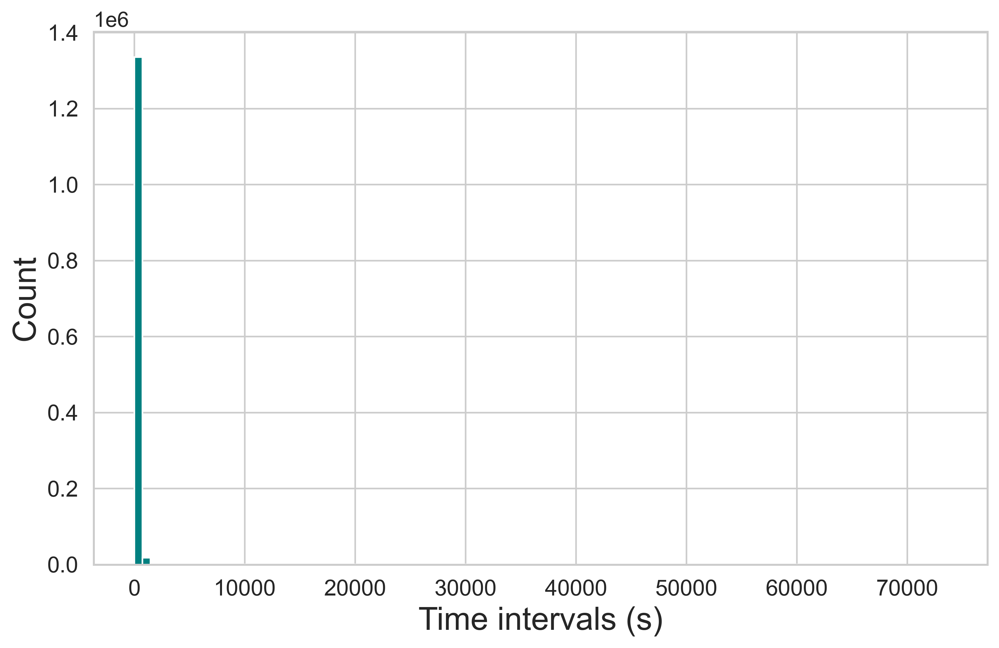

In [170]:
figure(figsize=(10, 6), dpi=400)
ax=trajectories['time_delta_in_seconds'].hist(bins=100, color='teal')
ax.set_xlabel('Time intervals (s)', fontsize=20)
ax.set_ylabel('Count', fontsize=20)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.savefig(r'../../figures/hist-time-intervals.png', dpi=400, bbox_inches='tight')

In [171]:
trajectories['time_delta_in_seconds'].max()

73596.0

In [172]:
trajectories['time_delta_in_seconds'].median()

41.0

In [173]:
trajectories['time_delta_in_seconds'].mean()

93.33630748516975

In [174]:
df_dist_outliers=trajectories[trajectories['dist']>15]

In [175]:
df_dist_outliers

,ServiceDateTime,Unnamed: 0.1,Unnamed: 0,DateKey,CalendarDate,Year,Month,OpKey,Operator,RtKey,...,Minute,Second,Date,Daytype,time,time_delta,time_delta_in_seconds,dist,speed,acc
43120,2022-04-01 17:51:03,108414,43654,8760,2022-04-01 00:00:00.000,2022,4,2,SATCo,3630,...,51,3,2022-04-01,Weekday,17:51:03,0 days 00:27:41,1661.0,15.433128,33.449285,0.009003
151871,2022-04-04 17:50:27,73742,152939,8763,2022-04-04 00:00:00.000,2022,4,2,SATCo,3630,...,50,27,2022-04-04,Weekday,17:50:27,0 days 00:27:32,1652.0,15.433128,33.631514,0.009101
205616,2022-04-05 17:53:05,34204,206300,8764,2022-04-05 00:00:00.000,2022,4,2,SATCo,3630,...,53,5,2022-04-05,Weekday,17:53:05,0 days 00:29:39,1779.0,15.433128,31.230614,0.007848
325834,2022-04-08 06:35:13,83989,366354,8767,2022-04-08 00:00:00.000,2022,4,2,SATCo,3620,...,35,13,2022-04-08,Weekday,06:35:13,0 days 00:52:32,3152.0,15.433128,17.626669,0.002500
366012,2022-04-08 17:52:24,84389,366875,8767,2022-04-08 00:00:00.000,2022,4,2,SATCo,3630,...,52,24,2022-04-08,Weekday,17:52:24,0 days 00:28:08,1688.0,15.433128,32.914255,0.008717
443572,2022-04-11 08:52:46,129899,469666,8770,2022-04-11 00:00:00.000,2022,4,2,SATCo,3655,...,52,46,2022-04-11,Weekday,08:52:46,0 days 00:39:09,2349.0,15.433123,23.652296,0.003014
476101,2022-04-11 17:55:02,111686,437762,8770,2022-04-11 00:00:00.000,2022,4,2,SATCo,3631,...,55,2,2022-04-11,Weekday,17:55:02,0 days 00:30:25,1825.0,15.433123,30.443421,0.007457
488956,2022-04-12 06:30:46,325383,529847,8771,2022-04-12 00:00:00.000,2022,4,2,SATCo,3664,...,30,46,2022-04-12,Weekday,06:30:46,0 days 00:52:52,3172.0,15.433123,17.515524,0.002469
489371,2022-04-12 06:38:18,388784,491128,8771,2022-04-12 00:00:00.000,2022,4,2,SATCo,3631,...,38,18,2022-04-12,Weekday,06:38:18,0 days 00:42:46,2566.0,15.433123,21.652082,0.003772
542555,2022-04-13 06:37:44,381295,544246,8772,2022-04-13 00:00:00.000,2022,4,2,SATCo,3631,...,37,44,2022-04-13,Weekday,06:37:44,0 days 00:39:28,2368.0,15.433123,23.462518,0.004429


In [176]:
df_time_intervals_outliers=trajectories[trajectories['time_delta_in_seconds']>50000]

In [177]:
df_time_intervals_outliers

,ServiceDateTime,Unnamed: 0.1,Unnamed: 0,DateKey,CalendarDate,Year,Month,OpKey,Operator,RtKey,...,Minute,Second,Date,Daytype,time,time_delta,time_delta_in_seconds,dist,speed,acc
44479,2022-04-01 18:14:07,1334372,1944,8760,2022-04-01 00:00:00.000,2022,4,1,VATCo,3515,...,14,7,2022-04-01,Weekday,18:14:07,0 days 16:03:31,57811.0,0.947721,0.059016,-2.678156e-06
48143,2022-04-01 19:24:26,1347071,21,8760,2022-04-01 00:00:00.000,2022,4,1,VATCo,3410,...,24,26,2022-04-01,Weekday,19:24:26,0 days 16:30:07,59407.0,0.631421,0.038263,2.879336e-07
201746,2022-04-05 16:49:19,1307711,163144,8764,2022-04-05 00:00:00.000,2022,4,1,VATCo,3410,...,49,19,2022-04-05,Weekday,16:49:19,0 days 16:41:46,60106.0,0.631544,0.037826,2.813304e-07
254721,2022-04-06 16:50:01,1307952,216585,8765,2022-04-06 00:00:00.000,2022,4,1,VATCo,3410,...,50,1,2022-04-06,Weekday,16:50:01,0 days 16:40:56,60056.0,0.631544,0.037857,2.817990e-07
317093,2022-04-07 19:25:06,1349116,269361,8766,2022-04-07 00:00:00.000,2022,4,1,VATCo,3410,...,25,6,2022-04-07,Weekday,19:25:06,0 days 17:50:33,64233.0,0.625590,0.035062,-6.645816e-05
371122,2022-04-08 19:24:57,1349412,323256,8767,2022-04-08 00:00:00.000,2022,4,1,VATCo,3410,...,24,57,2022-04-08,Weekday,19:24:57,0 days 16:32:00,59520.0,0.625590,0.037838,-6.213933e-05
408935,2022-04-09 18:11:21,1186001,411711,8768,2022-04-09 00:00:00.000,2022,4,3,UMASS,3622,...,11,21,2022-04-09,Weekend,18:11:21,0 days 15:56:34,57394.0,0.599712,0.037617,2.929942e-07
409963,2022-04-09 18:37:44,1349696,380420,8768,2022-04-09 00:00:00.000,2022,4,1,VATCo,3519,...,37,44,2022-04-09,Weekend,18:37:44,0 days 15:50:55,57055.0,0.627342,0.039583,-2.930769e-06
575200,2022-04-13 15:42:18,1125185,587700,8772,2022-04-13 00:00:00.000,2022,4,3,UMASS,3624,...,42,18,2022-04-13,Weekday,15:42:18,0 days 14:56:22,53782.0,0.000000,0.000000,0.000000e+00
686669,2022-04-15 17:50:30,1358234,646219,8774,2022-04-15 00:00:00.000,2022,4,1,VATCo,3410,...,50,30,2022-04-15,Weekday,17:50:30,0 days 15:40:00,56400.0,0.631544,0.040311,-5.179991e-06


In [178]:
#df[['ServiceDateTime','Date','Vehicle','dist','speed','acc']][(df['Vehicle'] == 1642) & (df['Date'] == '2022-04-04') ]

In [179]:
trajectories[['ServiceDateTime','Date','Vehicle','dist','speed','acc']][(trajectories['Vehicle'] == 1642) & (trajectories['Date'] == '2022-04-04') ]

,ServiceDateTime,Date,Vehicle,dist,speed,acc
113962,2022-04-04 07:14:26,2022-04-04,1642,0.000000,0.000000,0.000000
114021,2022-04-04 07:15:25,2022-04-04,1642,0.268592,16.388644,0.124176
114092,2022-04-04 07:16:27,2022-04-04,1642,0.310223,18.012945,0.011712
114136,2022-04-04 07:17:20,2022-04-04,1642,0.147543,10.021773,-0.067403
114190,2022-04-04 07:18:14,2022-04-04,1642,0.181551,12.103388,0.017233
114281,2022-04-04 07:19:42,2022-04-04,1642,0.474900,19.427711,0.037208
114293,2022-04-04 07:19:56,2022-04-04,1642,0.100140,25.750371,0.201892
114330,2022-04-04 07:20:43,2022-04-04,1642,0.110635,8.474147,-0.164323
114363,2022-04-04 07:21:22,2022-04-04,1642,0.154770,14.286429,0.066624
114382,2022-04-04 07:21:43,2022-04-04,1642,0.121848,20.888281,0.140538


In [180]:
trajectories[['ServiceDateTime','Date','Vehicle','dist','speed','acc']][(trajectories['Vehicle'] == 1729) & (trajectories['Date'] == '2022-04-19') ]

,ServiceDateTime,Date,Vehicle,dist,speed,acc
799562,2022-04-19 05:49:19,2022-04-19,1729,0.0,0.0,0.0


In [181]:
nans=trajectories[trajectories['dist'].isna()]

In [182]:
nans[['ServiceDateTime','Date','Vehicle','Lon','Lat','dist','speed','acc']]
#nans[['ServiceDateTime','Date','Vehicle','dist','speed','acc']][(nans['Vehicle'] == 1642) & (trajectories['Date'] == '2022-04-04') ]

,ServiceDateTime,Date,Vehicle,Lon,Lat,dist,speed,acc
4285,2022-04-01 07:01:50,2022-04-01,3307,-72.533010,42.393760,NaN,NaN,NaN
5457,2022-04-01 07:20:09,2022-04-01,3222,-72.533010,42.393760,NaN,NaN,NaN
5687,2022-04-01 07:24:38,2022-04-01,3305,NaN,NaN,NaN,NaN,NaN
6017,2022-04-01 07:31:01,2022-04-01,3305,-72.532480,42.405880,NaN,NaN,NaN
25276,2022-04-01 13:00:52,2022-04-01,7552,-72.633052,42.317699,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...
1273361,2022-04-29 07:15:45,2022-04-29,3313,-72.533010,42.393760,NaN,NaN,NaN
1277151,2022-04-29 08:24:42,2022-04-29,3319,NaN,NaN,NaN,NaN,NaN
1277353,2022-04-29 08:28:34,2022-04-29,3319,-72.533010,42.393760,NaN,NaN,NaN
1296554,2022-04-29 14:00:00,2022-04-29,7816,NaN,NaN,NaN,NaN,NaN


In [183]:
df[df['dist'].isna()]

,ServiceDateTime,Unnamed: 0,DateKey,CalendarDate,Year,Month,OpKey,Operator,RtKey,RtKey2,...,Minute,Second,Date,Daytype,time,time_delta,time_delta_in_seconds,dist,speed,acc
1015375,2022-04-12 09:08:42,530273,8771,2022-04-12 00:00:00.000,2022,4,3,UMASS,3391,1732,...,8,42,2022-04-12,Weekday,09:08:42,2023-03-10 00:00:41,41.0,NaN,NaN,NaN
1016670,2022-04-23 10:45:48,1038647,8782,2022-04-23 00:00:00.000,2022,4,3,UMASS,3709,1732,...,45,48,2022-04-23,Weekend,10:45:48,2023-03-10 00:09:21,561.0,NaN,NaN,NaN
1017014,2022-04-24 10:43:48,1056369,8783,2022-04-24 00:00:00.000,2022,4,3,UMASS,3709,1732,...,43,48,2022-04-24,Weekend,10:43:48,2023-03-10 00:10:13,613.0,NaN,NaN,NaN
1017911,2022-04-26 09:08:18,1160410,8785,2022-04-26 00:00:00.000,2022,4,3,UMASS,3709,1732,...,8,18,2022-04-26,Weekday,09:08:18,2023-03-10 02:31:43,9103.0,NaN,NaN,NaN
1020514,2022-04-15 07:27:11,687917,8774,2022-04-15 00:00:00.000,2022,4,3,UMASS,3391,1732,...,27,11,2022-04-15,Weekday,07:27:11,2023-03-10 00:04:44,284.0,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1342414,2022-04-11 14:00:34,434847,8770,2022-04-11 00:00:00.000,2022,4,1,VATCo,3515,1001,...,0,34,2022-04-11,Weekday,14:00:34,2023-03-10 00:02:34,154.0,NaN,NaN,NaN
1345596,2022-04-23 16:00:45,1003542,8782,2022-04-23 00:00:00.000,2022,4,1,VATCo,3516,1002,...,0,45,2022-04-23,Weekend,16:00:45,2023-03-10 00:00:45,45.0,NaN,NaN,NaN
1345659,2022-04-24 09:07:09,1038714,8783,2022-04-24 00:00:00.000,2022,4,1,VATCo,3515,1001,...,7,9,2022-04-24,Weekend,09:07:09,2023-03-10 00:03:09,189.0,NaN,NaN,NaN
1346555,2022-04-29 14:00:00,1271377,8788,2022-04-29 00:00:00.000,2022,4,1,VATCo,3516,1002,...,0,0,2022-04-29,Weekday,14:00:00,2023-03-10 00:04:00,240.0,NaN,NaN,NaN


In [184]:
df['Vehicle'][df['dist'].isna()].unique()

array([3212, 3221, 3222, 3225, 3228, 3301, 3302, 3303, 3305, 3306, 3307,
       3311, 3312, 3313, 3314, 3316, 3317, 3318, 3319, 3322, 3324, 3402,
       3501, 7552, 7610, 7660, 7661, 7662, 7802, 7811, 7813, 7814, 7815,
       7816], dtype=int64)

In [185]:
df[df['Lat'].isna()]

,ServiceDateTime,Unnamed: 0,DateKey,CalendarDate,Year,Month,OpKey,Operator,RtKey,RtKey2,...,Minute,Second,Date,Daytype,time,time_delta,time_delta_in_seconds,dist,speed,acc
1015374,2022-04-12 09:08:01,530272,8771,2022-04-12 00:00:00.000,2022,4,3,UMASS,3391,1732,...,8,1,2022-04-12,Weekday,09:08:01,NaT,NaN,0.0,0.0,0.0
1016669,2022-04-23 10:36:27,1038646,8782,2022-04-23 00:00:00.000,2022,4,3,UMASS,3709,1732,...,36,27,2022-04-23,Weekend,10:36:27,NaT,NaN,0.0,0.0,0.0
1017013,2022-04-24 10:33:35,1056368,8783,2022-04-24 00:00:00.000,2022,4,3,UMASS,3709,1732,...,33,35,2022-04-24,Weekend,10:33:35,NaT,NaN,0.0,0.0,0.0
1017910,2022-04-26 06:36:35,1160371,8785,2022-04-26 00:00:00.000,2022,4,3,UMASS,3709,1732,...,36,35,2022-04-26,Weekday,06:36:35,NaT,NaN,0.0,0.0,0.0
1020513,2022-04-15 07:22:27,687916,8774,2022-04-15 00:00:00.000,2022,4,3,UMASS,3391,1732,...,22,27,2022-04-15,Weekday,07:22:27,NaT,NaN,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1342413,2022-04-11 13:58:00,434846,8770,2022-04-11 00:00:00.000,2022,4,1,VATCo,3515,1001,...,58,0,2022-04-11,Weekday,13:58:00,NaT,NaN,0.0,0.0,0.0
1345595,2022-04-23 16:00:00,1003541,8782,2022-04-23 00:00:00.000,2022,4,1,VATCo,3516,1002,...,0,0,2022-04-23,Weekend,16:00:00,NaT,NaN,0.0,0.0,0.0
1345658,2022-04-24 09:04:00,1038713,8783,2022-04-24 00:00:00.000,2022,4,1,VATCo,3515,1001,...,4,0,2022-04-24,Weekend,09:04:00,NaT,NaN,0.0,0.0,0.0
1346554,2022-04-29 13:56:00,1271375,8788,2022-04-29 00:00:00.000,2022,4,1,VATCo,3516,1002,...,56,0,2022-04-29,Weekday,13:56:00,NaT,NaN,0.0,0.0,0.0


In [186]:
df[df['Lon'].isna()]

,ServiceDateTime,Unnamed: 0,DateKey,CalendarDate,Year,Month,OpKey,Operator,RtKey,RtKey2,...,Minute,Second,Date,Daytype,time,time_delta,time_delta_in_seconds,dist,speed,acc
1015374,2022-04-12 09:08:01,530272,8771,2022-04-12 00:00:00.000,2022,4,3,UMASS,3391,1732,...,8,1,2022-04-12,Weekday,09:08:01,NaT,NaN,0.0,0.0,0.0
1016669,2022-04-23 10:36:27,1038646,8782,2022-04-23 00:00:00.000,2022,4,3,UMASS,3709,1732,...,36,27,2022-04-23,Weekend,10:36:27,NaT,NaN,0.0,0.0,0.0
1017013,2022-04-24 10:33:35,1056368,8783,2022-04-24 00:00:00.000,2022,4,3,UMASS,3709,1732,...,33,35,2022-04-24,Weekend,10:33:35,NaT,NaN,0.0,0.0,0.0
1017910,2022-04-26 06:36:35,1160371,8785,2022-04-26 00:00:00.000,2022,4,3,UMASS,3709,1732,...,36,35,2022-04-26,Weekday,06:36:35,NaT,NaN,0.0,0.0,0.0
1020513,2022-04-15 07:22:27,687916,8774,2022-04-15 00:00:00.000,2022,4,3,UMASS,3391,1732,...,22,27,2022-04-15,Weekday,07:22:27,NaT,NaN,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1342413,2022-04-11 13:58:00,434846,8770,2022-04-11 00:00:00.000,2022,4,1,VATCo,3515,1001,...,58,0,2022-04-11,Weekday,13:58:00,NaT,NaN,0.0,0.0,0.0
1345595,2022-04-23 16:00:00,1003541,8782,2022-04-23 00:00:00.000,2022,4,1,VATCo,3516,1002,...,0,0,2022-04-23,Weekend,16:00:00,NaT,NaN,0.0,0.0,0.0
1345658,2022-04-24 09:04:00,1038713,8783,2022-04-24 00:00:00.000,2022,4,1,VATCo,3515,1001,...,4,0,2022-04-24,Weekend,09:04:00,NaT,NaN,0.0,0.0,0.0
1346554,2022-04-29 13:56:00,1271375,8788,2022-04-29 00:00:00.000,2022,4,1,VATCo,3516,1002,...,56,0,2022-04-29,Weekday,13:56:00,NaT,NaN,0.0,0.0,0.0


In [187]:
less_tan_two_seconds=trajectories[trajectories['time_delta_in_seconds']<2]

In [188]:
less_tan_two_seconds[less_tan_two_seconds['dist']>0]

,ServiceDateTime,Unnamed: 0.1,Unnamed: 0,DateKey,CalendarDate,Year,Month,OpKey,Operator,RtKey,...,Minute,Second,Date,Daytype,time,time_delta,time_delta_in_seconds,dist,speed,acc


In [189]:
bad_points=df[df['time_delta_in_seconds']< 2]

In [190]:
trajectories[['ServiceDateTime','Date','Vehicle','dist','speed','acc']][(trajectories['Vehicle'] == 7902 & (trajectories['Date'] == '2022-04-08'))]

,ServiceDateTime,Date,Vehicle,dist,speed,acc


In [191]:
trajectories[['ServiceDateTime','Date','Vehicle','dist','speed','acc']][(trajectories['Vehicle'] == 3303)]

,ServiceDateTime,Date,Vehicle,dist,speed,acc
0,2022-04-01 00:00:00,2022-04-01,3303,0.000000,0.000000,0.000000
15,2022-04-01 00:01:11,2022-04-01,3303,0.159006,8.062252,0.050763
38,2022-04-01 00:05:27,2022-04-01,3303,0.253337,3.562557,-0.007858
44,2022-04-01 00:06:13,2022-04-01,3303,0.072114,5.643678,0.020225
56,2022-04-01 00:07:43,2022-04-01,3303,0.067056,2.682246,-0.014710
...,...,...,...,...,...,...
1319987,2022-04-29 20:49:24,2022-04-29,3303,0.307753,11.913031,0.034135
1320013,2022-04-29 20:50:11,2022-04-29,3303,0.204431,15.658522,0.035625
1320041,2022-04-29 20:50:49,2022-04-29,3303,0.094113,8.915984,-0.079321
1320042,2022-04-29 20:50:49,2022-04-29,3303,0.000000,0.000000,0.000000


In [192]:
trajectories[['ServiceDateTime','Date','Vehicle','dist','speed','acc']][(trajectories['Vehicle'] == 7902) & (trajectories['Date'] == '2022-04-11') ]

,ServiceDateTime,Date,Vehicle,dist,speed,acc
448816,2022-04-11 10:25:49,2022-04-11,7902,0.000000,0.000000,0.000000
449306,2022-04-11 10:34:00,2022-04-11,7902,0.000000,0.000000,0.000000
449443,2022-04-11 10:36:17,2022-04-11,7902,0.631544,16.595308,0.054152
449444,2022-04-11 10:36:17,2022-04-11,7902,0.000000,0.000000,0.000000
449639,2022-04-11 10:39:29,2022-04-11,7902,0.313431,5.876833,0.013683
...,...,...,...,...,...,...
477110,2022-04-11 18:11:36,2022-04-11,7902,0.203997,22.949681,0.042521
477228,2022-04-11 18:13:37,2022-04-11,7902,0.249247,7.415607,-0.057391
477444,2022-04-11 18:17:36,2022-04-11,7902,0.219698,3.309266,-0.007681
477528,2022-04-11 18:19:04,2022-04-11,7902,0.208149,8.515180,0.026446


In [193]:
trajectories['dist'][(trajectories['Vehicle'] == 7902) & (trajectories['Date'] == '2022-04-13')].sum()

87.46669297702145

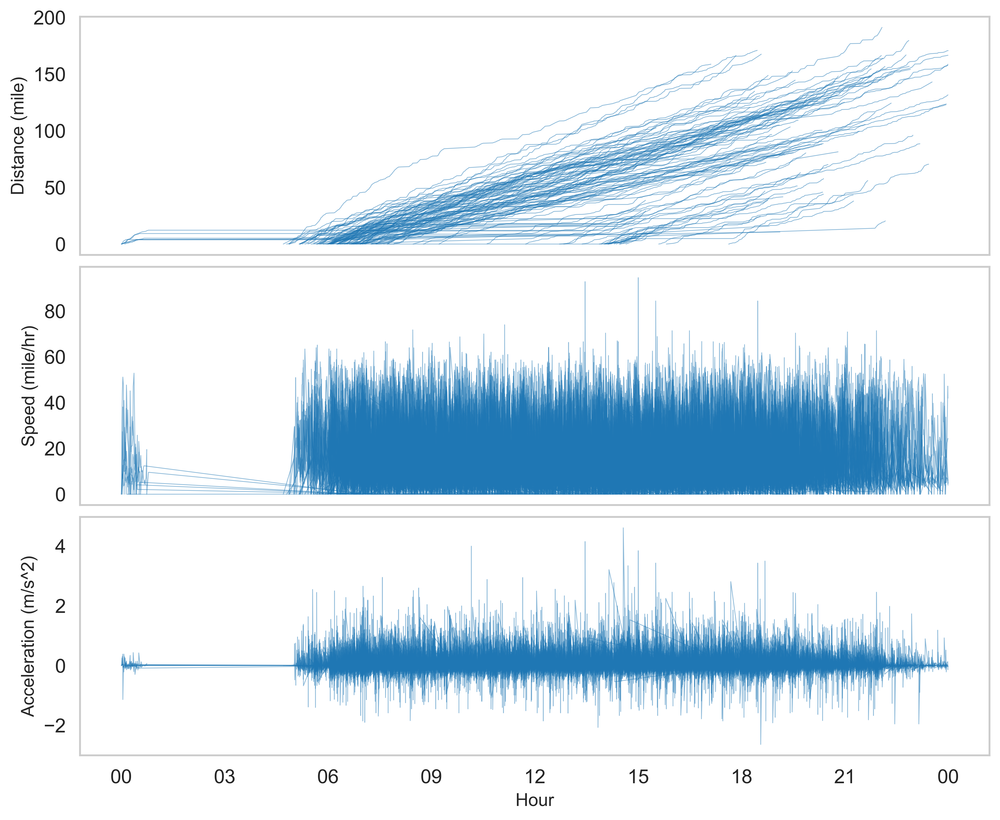

In [194]:
import matplotlib.pyplot as plt

# Create a facet plot with three rows and one column
fig, axs = plt.subplots(nrows=3, ncols=1, figsize=(11, 9), dpi=600)

# Reduce vertical distance between subplots to 0.05 inches
fig.subplots_adjust(hspace=0.05)

# Plot 1: distance vs. time
vehicle = plot_data['Vehicle'].unique()
for v in vehicle:
    plot_df = plot_data[plot_data['Vehicle'] == v]
    axs[0].plot(plot_df["dist"].cumsum(), marker='', color='#1f77b4', linewidth=0.5, alpha=0.5)
axs[0].set_ylabel("Distance (mile)", fontsize=12)
axs[0].grid()
axs[0].tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)

# Plot 2: speed vs. time
vehicle = plot_data['Vehicle'].unique()
for v in vehicle:
    plot_df = plot_data[plot_data['Vehicle'] == v]
    axs[1].plot(plot_df["speed"], marker='', color='#1f77b4', linewidth=0.5, alpha=0.5)
axs[1].set_ylabel("Speed (mile/hr)", fontsize=12)
axs[1].grid()
axs[1].tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)

# Plot 3: acceleration vs. time
vehicle = plot_data['Vehicle'].unique()
for v in vehicle:
    plot_df = plot_data[plot_data['Vehicle'] == v]
    axs[2].plot(plot_df["acc"], marker='', color='#1f77b4', linewidth=0.5, alpha=0.5)
axs[2].set_xlabel("Hour", fontsize=12)
axs[2].set_ylabel("Acceleration (m/s^2)", fontsize=12)
axs[2].grid()
date_form = DateFormatter("%H")
axs[2].xaxis.set_major_formatter(date_form)

# Show the combined plot
plt.show()


In [195]:
### Plot trajectories (new version facet plot- colored by powertrain- from 5Am-to 5AM)

In [196]:
# first I need to map powertrains as I want to color the lines by powertrain

In [197]:
df2 = pd.read_csv(r'../../data/tidy/vehicles-summary.csv', delimiter=',', skiprows=0, low_memory=False)

In [198]:
mydict = df2.groupby('Type')['Equipment ID'].agg(list).to_dict()
print (mydict)

{'conventional': [1406, 1510, 1513, 1515, 1618, 1619, 1621, 1630, 1632, 1552, 1553, 1554, 1555, 1556, 1557, 1558, 1559, 1561, 1562, 1640, 1641, 1642, 1643, 1644, 1645, 1646, 1647, 1648, 1649, 1563, 1564, 1565, 1566, 1567, 1568, 1569, 1571, 1572, 1573, 1574, 1575, 1576, 1577, 1578, 1650, 1651, 1652, 1653, 1654, 1655, 1656, 1657, 1658, 1659, 1660, 1661, 1662, 1663, 1664, 1701, 1810, 1811, 1812, 1813, 1814, 1815, 1816, 1817, 1818, 1819, 1821, 1822, 1823, 1824, 1825, 1826, 1830, 1831, 1832, 1833, 1834, 1835, 1836, 1837, 1710, 1711, 1712, 1713, 1714, 1840, 1841, 1842, 1843, 1844, 1845, 1846, 1847, 1848, 1849, 1670, 1671, 1672, 1673, 1715, 1716, 1717, 1718, 1719, 1720, 1850, 1851, 1852, 1853, 1854, 1855, 1856, 1721, 1722, 1723, 1857, 1858, 1859, 1860, 1861, 1724, 1725, 1726, 1727, 1728, 1729, 1862, 1863, 1864, 3211, 3307, 3308, 7610, 7550, 7551, 7660, 7661, 7662, 7552, 7801, 7802, 7811, 7812, 7813, 7814, 7815, 7553, 7554, 7816, 7817, 3201, 3202, 3203, 3203, 3204, 3205, 3212, 3213, 3214, 3215

In [199]:
d = {val:key for key, lst in mydict.items() for val in lst}
plot_data['Powertrain'] = plot_data['Vehicle'].map(d)

C:\Users\Mahsa\AppData\Local\Temp\ipykernel_14400\106908817.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  plot_data['Powertrain'] = plot_data['Vehicle'].map(d)


In [200]:
plot_data['Powertrain'].unique()

array(['conventional', 'electric', 'hybrid'], dtype=object)

In [201]:
plot_data.columns

Index(['Unnamed: 0.1', 'Unnamed: 0', 'DateKey', 'CalendarDate', 'Year',
       'Month', 'OpKey', 'Operator', 'RtKey', 'RtKey2', 'Route', 'RouteName',
       'TripKey', 'Trip', 'StopKey', 'Stop', 'StopName', 'Lat', 'Lon',
       'Vehicle', 'VehicleType', 'SeatedCap', 'TotalCap', 'Boards', 'Alights',
       'Onboard', 'Bike', 'Wheelchair', 'Weekday', 'Hour', 'Minute', 'Second',
       'Date', 'Daytype', 'time', 'time_delta', 'time_delta_in_seconds',
       'dist', 'speed', 'acc', 'Powertrain'],
      dtype='object')

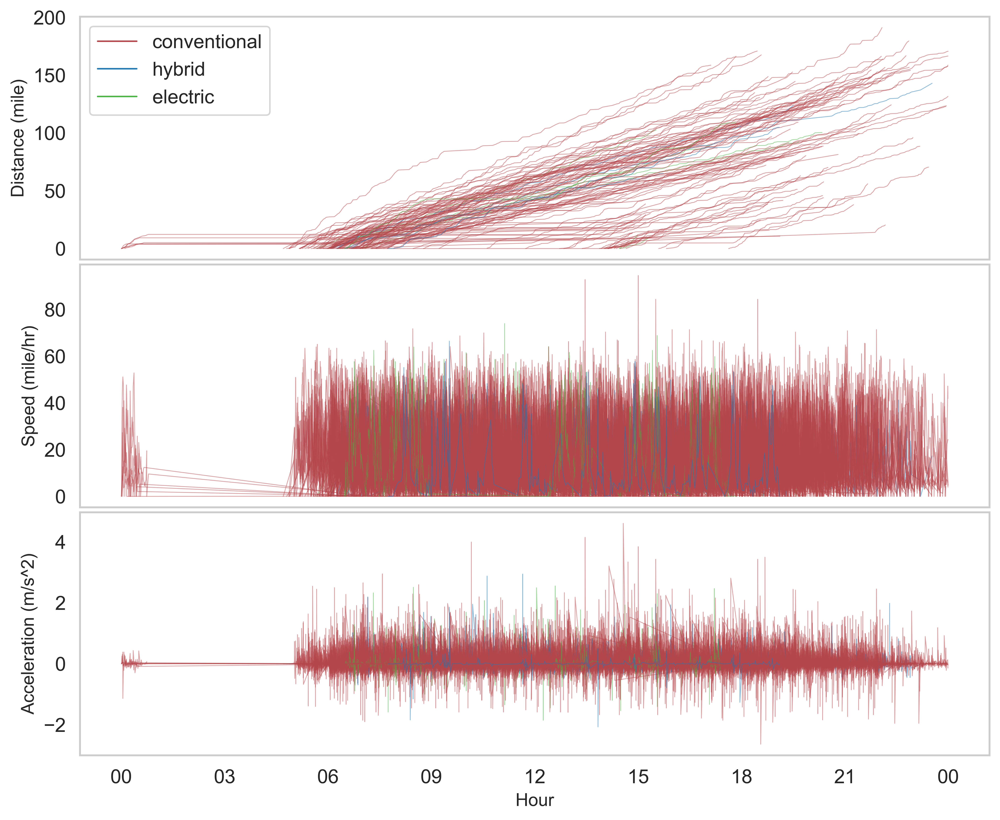

<Figure size 640x480 with 0 Axes>

In [202]:
import matplotlib.pyplot as plt

# Convert time column to datetime format
#plot_data['ServiceDateTime'] = pd.to_datetime(plot_data['ServiceDateTime'])

# Set x-axis limits to start at 5AM and end at tomorrow 5AM
start_time = pd.to_datetime('5:00:00')
end_time = start_time + pd.DateOffset(days=1)
for ax in axs:
    ax.set_xlim(start_time, end_time)

# Create a facet plot with three rows and one column
fig, axs = plt.subplots(nrows=3, ncols=1, figsize=(11, 9), dpi=600)

# Reduce vertical distance between subplots to 0.05 inches
fig.subplots_adjust(hspace=0.02)

# Plot 1: distance vs. time
vehicle = plot_data['Vehicle'].unique()
for v in vehicle:
    plot_df = plot_data[plot_data['Vehicle'] == v]
    powertrain=plot_df.iloc[1]['Powertrain']
    if powertrain=='conventional':
        axs[0].plot(plot_df["dist"].cumsum(), marker='', c='#B4464B', linewidth=0.5, alpha=0.5)
    elif powertrain=='hybrid':
        axs[0].plot(plot_df["dist"].cumsum(), marker='', c='#1f77b4', linewidth=0.5, alpha=0.5)
    else:
        axs[0].plot(plot_df["dist"].cumsum(), marker='', c='#4BB446', linewidth=0.5, alpha=0.5)
    #axs[0].plot(plot_df["dist"].cumsum(), marker='', color='#1f77b4', linewidth=0.5, alpha=0.5)
    
axs[0].set_ylabel("Distance (mile)", fontsize=12)
axs[0].grid()
axs[0].tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)
# Legend
custom_lines = [Line2D([0], [0], color='#B4464B', lw=1),
                Line2D([0], [0], color='#1f77b4', lw=1),
                Line2D([0], [0], color='#4BB446', lw=1)]
axs[0].legend(custom_lines, ['conventional', 'hybrid', 'electric'])

# Plot 2: speed vs. time
for v in vehicle:
    plot_df = plot_data[plot_data['Vehicle'] == v]
    powertrain=plot_df.iloc[1]['Powertrain']
    if powertrain=='conventional':  
        axs[1].plot(plot_df["speed"], marker='', color='#B4464B', linewidth=0.5, alpha=0.5)
    elif powertrain=='hybrid':
        axs[1].plot(plot_df["speed"], marker='', color='#1f77b4', linewidth=0.5, alpha=0.5)
    else:
        axs[1].plot(plot_df["speed"], marker='', color='#4BB446', linewidth=0.5, alpha=0.5)
    #axs[1].plot(plot_df["speed"], marker='', color='#1f77b4', linewidth=0.5, alpha=0.5)
axs[1].set_ylabel("Speed (mile/hr)", fontsize=12)
axs[1].grid()
axs[1].tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)

# Plot 3: acceleration vs. time
for v in vehicle:
    plot_df = plot_data[plot_data['Vehicle'] == v]
    powertrain=plot_df.iloc[1]['Powertrain']
    if powertrain=='conventional':  
        axs[2].plot(plot_df["acc"], marker='', color='#B4464B', linewidth=0.5, alpha=0.5)
    elif powertrain=='hybrid':
        axs[2].plot(plot_df["acc"], marker='', color='#1f77b4', linewidth=0.5, alpha=0.5)
    else:
        axs[2].plot(plot_df["acc"], marker='', color='#4BB446', linewidth=0.5, alpha=0.5)
    #axs[2].plot(plot_df["acc"], marker='', color='#1f77b4', linewidth=0.5, alpha=0.5)
axs[2].set_xlabel("Hour", fontsize=12)
axs[2].set_ylabel("Acceleration (m/s^2)", fontsize=12)
axs[2].grid()
date_form = DateFormatter("%H")
axs[2].xaxis.set_major_formatter(date_form)

# Show the combined plot
plt.show()

# Saving
plt.savefig(r'../../figures/trajectories-facet.png', dpi=600, bbox_inches='tight')

In [203]:
# Now I want to shift the plot from 5AM to 5AM

In [204]:
# Read the file with service time
df = pd.read_csv(r'../../results/computed-trajectories2.csv', delimiter=',', skiprows=0, low_memory=False)
df['ServiceDateTime'] = pd.to_datetime(df['ServiceDateTime'])

# Set start and end time
start_time = pd.Timestamp('2022-04-04 05:00:00')
end_time = pd.Timestamp('2022-04-05 05:00:00')

plot_data.reset_index()
# Select data between start_time and end_time
plot_data = df[(df['ServiceDateTime'] >= start_time) & (df['ServiceDateTime'] < end_time)]

In [205]:
plot_data = plot_data.set_index("ServiceDateTime")

In [206]:
df2 = pd.read_csv(r'../../data/tidy/vehicles-summary.csv', delimiter=',', skiprows=0, low_memory=False)
mydict = df2.groupby('Type')['Equipment ID'].agg(list).to_dict()
d = {val:key for key, lst in mydict.items() for val in lst}
plot_data['Powertrain'] = plot_data['Vehicle'].map(d)

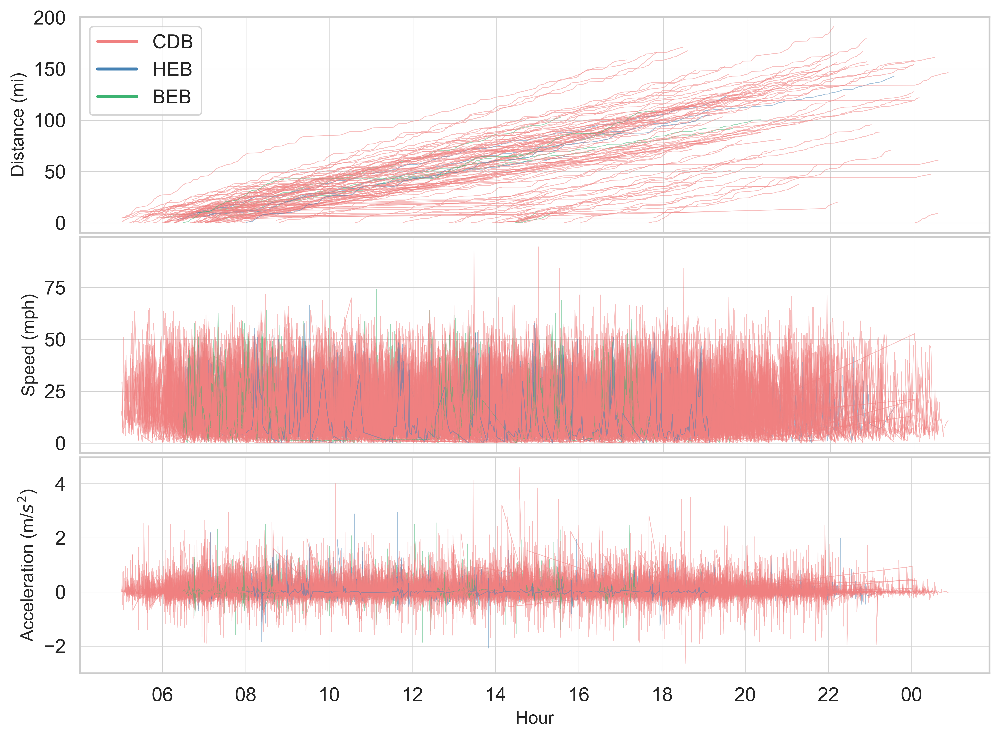

In [228]:
import matplotlib.pyplot as plt

# Convert time column to datetime format
#plot_data['ServiceDateTime'] = pd.to_datetime(plot_data['ServiceDateTime'])

# Set x-axis limits to start at 5AM and end at tomorrow 5AM
start_time = pd.to_datetime('5:00:00')
end_time = start_time + pd.DateOffset(days=1)
for ax in axs:
    ax.set_xlim(start_time, end_time)

# Create a facet plot with three rows and one column
fig, axs = plt.subplots(nrows=3, ncols=1, figsize=(11, 8), dpi=600)

# Reduce vertical distance between subplots to 0.05 inches
fig.subplots_adjust(hspace=0.02)

# Plot 1: distance vs. time
vehicle = plot_data['Vehicle'].unique()
for v in vehicle:
    plot_df = plot_data[plot_data['Vehicle'] == v]
    plot_df = plot_df.loc[(plot_df['dist'].notnull()) & (plot_df['dist'] != 0)]
    powertrain=plot_df.iloc[1]['Powertrain']
    if powertrain=='conventional':
        axs[0].plot(plot_df["dist"].cumsum(), marker='', c='lightcoral', linewidth=0.5, alpha=0.5)
    elif powertrain=='hybrid':
        axs[0].plot(plot_df["dist"].cumsum(), marker='', c='steelblue', linewidth=0.5, alpha=0.5)
    else:
        axs[0].plot(plot_df["dist"].cumsum(), marker='', c='mediumseagreen', linewidth=0.5, alpha=0.5)
    #axs[0].plot(plot_df["dist"].cumsum(), marker='', color='#1f77b4', linewidth=0.5, alpha=0.5)
    
axs[0].set_ylabel("Distance (mi)", fontsize=12)

axs[0].grid(color='lightgrey', linewidth=0.4)
axs[0].tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)
# Legend
custom_lines = [Line2D([0], [0], color='lightcoral', lw=2),
                Line2D([0], [0], color='steelblue', lw=2),
                Line2D([0], [0], color='mediumseagreen', lw=2)]
axs[0].legend(custom_lines, ['CDB', 'HEB', 'BEB'])

# Plot 2: speed vs. time
for v in vehicle:
    plot_df = plot_data[plot_data['Vehicle'] == v]
    plot_df = plot_df.loc[(plot_df['speed'].notnull()) & (plot_df['speed'] != 0)]
    powertrain=plot_df.iloc[1]['Powertrain']
    if powertrain=='conventional':  
        axs[1].plot(plot_df["speed"], marker='', color='lightcoral', linewidth=0.5, alpha=0.5)
    elif powertrain=='hybrid':
        axs[1].plot(plot_df["speed"], marker='', color='steelblue', linewidth=0.5, alpha=0.5)
    else:
        axs[1].plot(plot_df["speed"], marker='', color='mediumseagreen', linewidth=0.5, alpha=0.5)
    #axs[1].plot(plot_df["speed"], marker='', color='#1f77b4', linewidth=0.5, alpha=0.5)
axs[1].set_ylabel("Speed (mph)", fontsize=12)

axs[1].grid(color='lightgrey', linewidth=0.4)
axs[1].tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)

# Plot 3: acceleration vs. time
for v in vehicle:
    plot_df = plot_data[plot_data['Vehicle'] == v]
    plot_df = plot_df.loc[(plot_df['acc'].notnull()) & (plot_df['acc'] != 0)]
    powertrain=plot_df.iloc[1]['Powertrain']
    if powertrain=='conventional':  
        axs[2].plot(plot_df["acc"], marker='', color='lightcoral', linewidth=0.5, alpha=0.5)
    elif powertrain=='hybrid':
        axs[2].plot(plot_df["acc"], marker='', color='steelblue', linewidth=0.5, alpha=0.5)
    else:
        axs[2].plot(plot_df["acc"], marker='', color='mediumseagreen', linewidth=0.5, alpha=0.5)
    #axs[2].plot(plot_df["acc"], marker='', color='#1f77b4', linewidth=0.5, alpha=0.5)
axs[2].set_xlabel("Hour", fontsize=12)
axs[2].set_ylabel(r"Acceleration (m/$s^2$)", fontsize=12)

axs[2].grid(color='lightgrey', linewidth=0.4)

date_form = DateFormatter("%H")
axs[2].xaxis.set_major_formatter(date_form)

# Show the combined plot
plt.show()

# Saving
fig.savefig(r'../../figures/trajectories-facet.png', dpi=600, bbox_inches='tight')

In [208]:
##### Remove outliers and just keep 95% of data

In [209]:
#lower_speed_threshold = plot_data['speed'].quantile(0.005)
upper_speed_threshold = plot_data['speed'].quantile(0.99)
plot_data_modified = plot_data[(plot_data['speed'] < upper_speed_threshold)] #& (plot_data['speed'] < upper_speed_threshold)]
#dist_threshold = plot_data['dist'].quantile(0.95)
#speed_threshold = plot_data['speed'].quantile(0.95)
#acc_threshold = plot_data['acc'].quantile(0.95)
#plot_data = plot_data.loc[(plot_data['dist'] <= dist_threshold) & (plot_data['speed'] <= speed_threshold) & (plot_data['acc'] <= acc_threshold)]

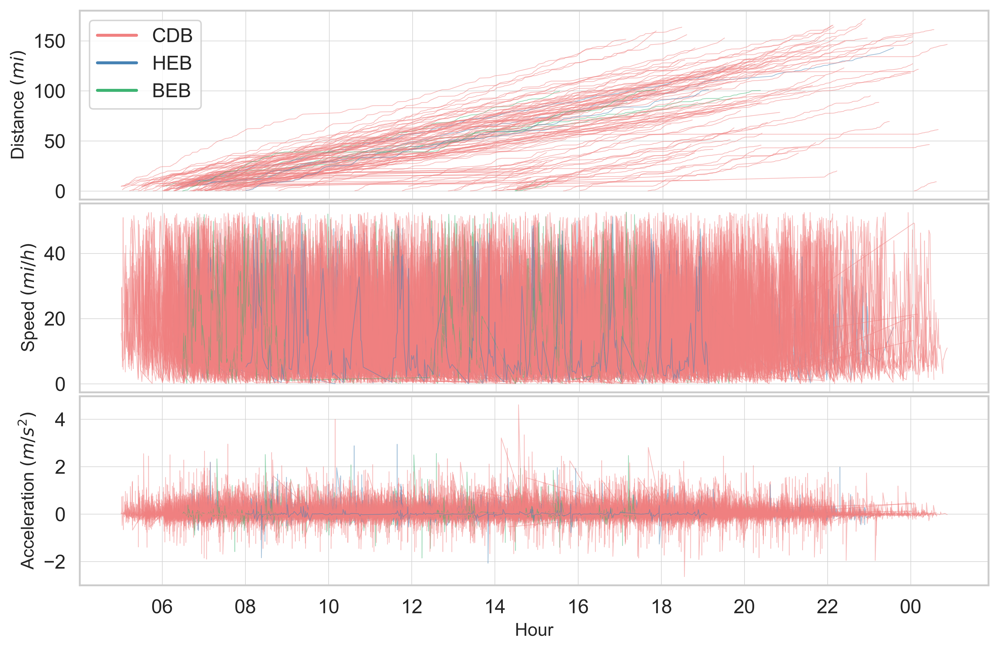

In [210]:
import matplotlib.pyplot as plt

# Convert time column to datetime format
#plot_data['ServiceDateTime'] = pd.to_datetime(plot_data['ServiceDateTime'])

# Set x-axis limits to start at 5AM and end at tomorrow 5AM
start_time = pd.to_datetime('5:00:00')
end_time = start_time + pd.DateOffset(days=1)
for ax in axs:
    ax.set_xlim(start_time, end_time)

# Create a facet plot with three rows and one column
fig, axs = plt.subplots(nrows=3, ncols=1, figsize=(11, 7), dpi=600)

# Reduce vertical distance between subplots to 0.05 inches
fig.subplots_adjust(hspace=0.02)

# Plot 1: distance vs. time
vehicle = plot_data_modified['Vehicle'].unique()
for v in vehicle:
    plot_df = plot_data_modified[plot_data_modified['Vehicle'] == v]
    plot_df = plot_df.loc[(plot_df['dist'].notnull()) & (plot_df['dist'] != 0)]
    powertrain=plot_df.iloc[1]['Powertrain']
    if powertrain=='conventional':
        axs[0].plot(plot_df["dist"].cumsum(), marker='', c='lightcoral', linewidth=0.5, alpha=0.5)
    elif powertrain=='hybrid':
        axs[0].plot(plot_df["dist"].cumsum(), marker='', c='steelblue', linewidth=0.5, alpha=0.5)
    else:
        axs[0].plot(plot_df["dist"].cumsum(), marker='', c='mediumseagreen', linewidth=0.5, alpha=0.5)
    #axs[0].plot(plot_df["dist"].cumsum(), marker='', color='#1f77b4', linewidth=0.5, alpha=0.5)
    
axs[0].set_ylabel("Distance (mile)", fontsize=12)
axs[0].set_ylabel(r'Distance $(mi)$')

axs[0].grid(color='lightgrey', linewidth=0.4)
axs[0].tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)
# Legend
custom_lines = [Line2D([0], [0], color='lightcoral', lw=2),
                Line2D([0], [0], color='steelblue', lw=2),
                Line2D([0], [0], color='mediumseagreen', lw=2)]
axs[0].legend(custom_lines, ['CDB', 'HEB', 'BEB'])

# Plot 2: speed vs. time
for v in vehicle:
    plot_df = plot_data_modified[plot_data_modified['Vehicle'] == v]
    plot_df = plot_df.loc[(plot_df['speed'].notnull()) & (plot_df['speed'] != 0)]
    powertrain=plot_df.iloc[1]['Powertrain']
    if powertrain=='conventional':  
        axs[1].plot(plot_df["speed"], marker='', color='lightcoral', linewidth=0.5, alpha=0.5)
    elif powertrain=='hybrid':
        axs[1].plot(plot_df["speed"], marker='', color='steelblue', linewidth=0.5, alpha=0.5)
    else:
        axs[1].plot(plot_df["speed"], marker='', color='mediumseagreen', linewidth=0.5, alpha=0.5)
    #axs[1].plot(plot_df["speed"], marker='', color='#1f77b4', linewidth=0.5, alpha=0.5)
axs[1].set_ylabel("Speed (mile/hr)", fontsize=12)
axs[1].set_ylabel(r'Speed $(mi/h)$')

axs[1].grid(color='lightgrey', linewidth=0.4)
axs[1].tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)

# Plot 3: acceleration vs. time
for v in vehicle:
    plot_df = plot_data_modified[plot_data_modified['Vehicle'] == v]
    plot_df = plot_df.loc[(plot_df['acc'].notnull()) & (plot_df['acc'] != 0)]
    powertrain=plot_df.iloc[1]['Powertrain']
    if powertrain=='conventional':  
        axs[2].plot(plot_df["acc"], marker='', color='lightcoral', linewidth=0.5, alpha=0.5)
    elif powertrain=='hybrid':
        axs[2].plot(plot_df["acc"], marker='', color='steelblue', linewidth=0.5, alpha=0.5)
    else:
        axs[2].plot(plot_df["acc"], marker='', color='mediumseagreen', linewidth=0.5, alpha=0.5)
    #axs[2].plot(plot_df["acc"], marker='', color='#1f77b4', linewidth=0.5, alpha=0.5)
axs[2].set_xlabel("Hour", fontsize=12)
axs[2].set_ylabel("Acceleration (m/s^2)", fontsize=12)
axs[2].set_ylabel(r'Acceleration $(m/s^2)$')

axs[2].grid(color='lightgrey', linewidth=0.4)

date_form = DateFormatter("%H")
axs[2].xaxis.set_major_formatter(date_form)

# Show the combined plot
plt.show()

# Saving
fig.savefig(r'../../figures/trajectories-facet.png', dpi=600, bbox_inches='tight')

In [211]:
distance_list=[]
for v in vehicle:
    plot_df = plot_data[plot_data['Vehicle'] == v]
    distance_current=plot_df["dist"].sum()
    distance_list.append(distance_current)

In [212]:
sum(distance_list)/len(distance_list)

91.14752296989457

In [213]:
max(distance_list)

191.1831331668722

In [214]:
min(distance_list)

6.811063467412426

In [215]:
import statistics
statistics.median(distance_list)

89.39259098303046

In [216]:
statistics.mean(distance_list)

91.14752296989454

In [217]:
speed_list=[]
for v in vehicle:
    plot_df = plot_data_modified[plot_data_modified['Vehicle'] == v]
    speed_current=plot_df["speed"].mean()
    speed_list.append(speed_current)

In [218]:
sum(speed_list)/len(speed_list)

15.404140964258055

In [219]:
speed_list=[]
for v in vehicle:
    plot_df = plot_data[plot_data['Vehicle'] == v].reset_index()
    for i in plot_df.index:
        speed_current=plot_df.at[i, "speed"]
        if np.isnan(speed_current):
            pass
        else:
            speed_list.append(speed_current)

In [220]:
max(speed_list)

94.58673304886575

In [221]:
min(speed_list)

0.0

In [222]:
statistics.median(speed_list)

12.493527379808151

In [223]:
statistics.mean(speed_list)

16.204418599821867

In [224]:
acc_list=[]
for v in vehicle:
    plot_df = plot_data[plot_data['Vehicle'] == v].reset_index()
    acc_current=plot_df["acc"].mean()
    acc_list.append(acc_current)

In [225]:
sum(acc_list)/len(acc_list)

0.05356414495453876

In [226]:
acc_list=[]
for v in vehicle:
    plot_df = plot_data_modified[plot_data_modified['Vehicle'] == v].reset_index()
    for i in plot_df.index:
        acc_current=plot_df.at[i, "acc"]
        if np.isnan(acc_current):
            pass
        else:
            acc_list.append(acc_current)

In [399]:
max(acc_list)

4.609256230790607

In [400]:
statistics.median(acc_list)

0.0

In [401]:
min(acc_list)

-2.637238047296332

In [402]:
statistics.mean(acc_list)

0.049943658259747635

In [403]:
### Modified plot from 5 am to 5 am

In [404]:
start_time = '2022-04-04 05:00:00'
end_time = '2022-04-05 05:00:00'

plot_data_modified = trajectories.loc[(trajectories['ServiceDateTime'] >= start_time) & (trajectories['ServiceDateTime'] < end_time)].copy()

In [ ]:
df2 = pd.read_csv(r'../../data/tidy/vehicles-summary.csv', delimiter=',', skiprows=0, low_memory=False)

In [ ]:
mydict = df2.groupby('Type')['Equipment ID'].agg(list).to_dict()
print (mydict)

In [ ]:
d = {val:key for key, lst in mydict.items() for val in lst}
plot_data_modified['Powertrain'] = plot_data_modified['Vehicle'].map(d)

In [ ]:
plot_data_modified['Powertrain'].unique()

In [ ]:
plot_data_modified=plot_data_modified.set_index('ServiceDateTime')